# Taxi Navigation with Q-learning and SARSA


\
This project involves implementing Q-learning and SARSA algorithms for a taxi navigation problem using the Gym library.

#### Question: Why use reinforcement learning instead of traditional search algorithm?

Reinforcement learning inherently balances between exploring new actions to find more rewarding strategies and exploiting known actions that yield high rewards. Traditional search algorithms generally don’t handle this exploration/exploitation trade-off, they usually follow a predetermined path.

In addtion, RL algorithms learn from the consequences of their actions (estimating a value/policy function that serves as a kind of heuristic function), making them ideal for scenarios where it’s impractical to model the environment completely before making decisions. Traditional search methods often require a complete and accurate model of the environment.

#

### Task:

**Environment**: A taxi needs to pick up and drop off a passenger at designated locations. The state of the environment changes based on the taxi’s actions.

**Objective**: Train a model that minimize the number of steps the taxi takes to pick up and drop off the passenger while avoiding illegal actions.

\
**Q-learning and SARSA**

\
According to [Geeks For Geeks](https://www.geeksforgeeks.org/differences-between-q-learning-and-sarsa/), both reinforcement learning algorithms involve learning the best actions to take in given states to maximize the cumulative reward.

1. Q-learning is **off-policy**, updates its Q-values using the maximum possible future reward, independently of the agent’s actions.

    Update rule: $Q(s, a) \leftarrow Q(s, a) + \alpha [r + \gamma \max_{a^{\prime}} Q(s^{\prime}, a^{\prime}) - Q(s, a)]$
    - $s$ is the current state 
    - $a$ is the current action taken
    - $s^{\prime}$ is the new state after taking action $a$
    - $a^{\prime}$ is any possible action from the new state $s^{\prime}$
    - $\max_{a^{\prime}}$ is the maximum Q-value action of the new state $s^{\prime}$
    - $r$ is the reward received after taken current action $a$
    - $\alpha$ is the learning rate 
    - $\gamma$ is the discount factor

##

2. SARSA (State-Action-Reward-State-Action) is **on-policy**, meaning it updates its Q-values based on the actions actually taken by the policy, including the exploration steps.

    Update rule: $Q(s, a) \leftarrow Q(s, a) + \alpha [r + \gamma Q(s^{\prime}, a^{\prime}) - Q(s, a)]$
    - $a^{\prime}$ is the action actually taken from the new state $s^{\prime}$.

#### Rewards

- -1 per step the agent takes (to encourage the agent to minimise steps needed)

- +20 reward for delivering the passenger

- -10 penalty for executing “pickup” and “drop-off” actions illegally

### Set Up the Gym Environment

\
Import packages that needed for this assignment:

In [1]:
import gym
import numpy as np
from matplotlib import pyplot as plt

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


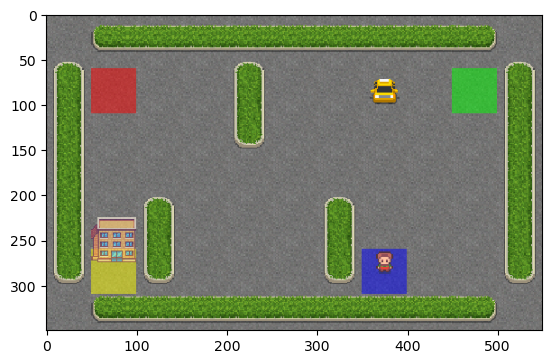

In [2]:
# Initialize and render the environment using the provided code snippets in the assignment spec:
env = gym.make("Taxi-v3", render_mode="rgb_array")
n_actions = env.action_space.n
n_states = env.observation_space.n
state = env.reset()
rendered_env = env.render()

# Visulize the rendered environment using "rgb_array"
plt.imshow(rendered_env)
plt.show()

The following is the state representation:

In [3]:
state

(433, {'prob': 1.0, 'action_mask': array([0, 1, 1, 0, 0, 0], dtype=int8)})

This representation tells us the exact conditions in the environment and what actions can legally take.

\
**State Number: 327**

States are encoded as single integers, a specific configuration of the taxi’s location, the passenger’s status, and the destination.

\
**Probability: {'prob': 1.0}**

This probability of the state description refers to the transition probability. Given Taxi-v3 is an deterministic environment, taking an action in a given state always results in the same next state (predicted next state without any randomness).

\
**Action Mask: {'action_mask': array([1, 1, 1, 0, 0, 0], dtype=int8)}**

This array indicates which actions are valid in the current state. Each entry in the array corresponds to a possible action:

- Move South (0)

- Move North (1)

- Move East (2)

- Move West (3)

- Pickup Passenger (4)

- Drop off Passenger (5)

The values in the array will be 1 for actions that are valid and 0 for actions that are invalid given the current state.

### Implement the Algorithms

1. Initialize Q-values: Set up a Q-table to keep track of the expected rewards for each action in each state.

2. Choose actions: Implement a policy to choose actions based on current Q-values (e.g. greedy, ε-greedy, softmax).

3. Update Q-values: After each action, update the Q-values based on the rewards received and the maximum expected future rewards.

#

#### Pseudocode:

Initialize Q-table with zero values

For each episode:

- Initialize the state $s$

    - While the episode is not done:

        - Choose action $a$ from state $s$ using a policy

        - Take action $a$, observe reward $r$, and next state $s^{\prime}$

        - Update the Q-table using:

            - If update rule == Q-learning: 
            
                - $Q(s, a) \leftarrow Q(s, a) + \alpha [r + \gamma \max_{a^{\prime}} Q(s^{\prime}, a^{\prime}) - Q(s, a)]$

                - Update state $s$ to $s^{\prime}$

            - If update rule == SARSA: 
            
                - $Q(s, a) \leftarrow Q(s, a) + \alpha [r + \gamma Q(s^{\prime}, a^{\prime}) - Q(s, a)]$

                - Update state $s$ to $s^{\prime}$ and action $a$ to  $a^{\prime}$


    - End While

Repeat for number of episodes

#### Q-table Initialization

#### Q-table representation

|  s/a | a0 | a1 | a2 | a3 | a4 | a5 |
|:----:|----|:--:|:--:|:--:|:--:|----|
| s0   |    |    |    |    |    |    |
| s1   |    |    |    |    |    |    |
| ...  |    |    |    |    |    |    |
| s499 |    |    |    |    |    |    |

In [3]:
Q = np.zeros([n_states, n_actions])
print(f"Q-table shape: {Q.shape}")

Q-table shape: (500, 6)


#### Action Selection Policies

It dictates how an agent chooses actions based on the state it is in. The goal is to balance exploration (trying new things) with exploitation (using known information to achieve higher rewards).

#
1. Greedy - The agent always chooses the action with the highest estimated reward. This method is purely exploitative and does not explore, which can lead to suboptimal learning because the agent might get stuck in local optima.

#
2. ε-Greedy 

- Exploitation: With probability 1 - ε, the agent chooses the action that has the highest estimated reward based on current knowledge.

- Exploration: With probability ε, the agent randomly selects any action. This random action selection allows the agent to explore new strategies.

- Over time, ε decaies  meaning the agent explores less as it becomes more confident in its knowledge.

#
3. Softmax - This method provides a more sophisticated way to handle the trade-off between exploration and exploitation

- Actions are selected according to the probabilities proportional to the exponential of their estimated values.

- The probability of selecting action $a$ in state $s$ is given by: $P(a|s) = \frac{e^{Q(s, a) / \tau}}{\sum_{b} e^{Q(s, b) / \tau}}$

- $\tau$ is a temperature parameter that controls the level of exploration. High values lead to more exploration, low values make the behavior closer to the greedy strategy.

In [4]:
def select_action(Q, policy, state, epsilon, tau):
    if policy == "greedy":
        return np.argmax(Q[state]) # greedy method equal to epsilon-greedy when epsilon=0
    
    if policy == "epsilon_greedy":
        if np.random.uniform(0, 1) < epsilon:
            return np.random.choice(len(Q[state]))
        else:
            return np.argmax(Q[state])
        
    if policy == "softmax":
        vals = Q[state] / tau
        exp_vals = np.exp(vals - np.max(vals))
        probabilities = exp_vals / np.sum(exp_vals)
        return np.random.choice(len(Q[state]), p=probabilities)

#### Update the Q-table Function

In [5]:
def update_Q(Q, state, action, alpha, reward, gamma, next_state, next_action, update_rule):
    if update_rule == "Q-learning":
        Q[state, action] = Q[state, action] + alpha * (reward + gamma * np.max(Q[next_state]) - Q[state, action])
    if update_rule == "SARSA":
        Q[state, action] = Q[state, action] + alpha * (reward + gamma * Q[next_state, next_action] - Q[state, action])
    return Q

#### Train loop

In [6]:
def train(Q, episodes, alpha, gamma, epsilon, tau, policy, update_rule): 
    # Set up the reward and step list for plotting
    rewards = []
    steps = []
    for episode in range(episodes):
        # Initialize the state s
        state = env.reset()[0]
        done = False
        total_reward, step_count = 0, 0
        action = select_action(Q, policy, state, epsilon, tau)
        
        while not done:            
            next_state, reward, done, truncated, info = env.step(action)
            # Choose next action using a policy
            next_action = select_action(Q, policy, next_state, epsilon, tau)     
            # Update Q-table
            Q = update_Q(Q, state, action, alpha, reward, gamma, next_state, next_action, update_rule)
            
            total_reward += reward
            step_count += 1       
            state = next_state
            action = next_action
        
        rewards.append(total_reward)
        steps.append(step_count)
        
    return Q, rewards, steps

**env.step(action)** is used to advance the environment to the next state based on the action taken by the agent.

The env.step(action) method returns a tuple containing the following elements:

1. **next_state_info**: The new state of the environment after the action has been executed

2. **reward**: A numerical value representing the reward received after executing the action

3. **done**: A boolean flag indicating whether the episode has ended

4. **turncated**: The environment is stopped early due to hitting a user-defined limit on the length of the episodes

5. **info**: A dictionary that can provide additional data about the transition

### Experiments

In this part, I am going to experiment with different policies, update rules, and hyperparameters.

\
Metrics will be used to evaluate the performance:

1. Cumulative Reward: The total reward accumulated over an episode

2. Stability: How consistent the agent’s performance is across different runs

The following function will plot the accumulated reward per episode and the number of steps taken by the agent in each episode:

In [7]:
def plot_results(rewards, steps):
    for i in range(len(rewards)):
        if i % 200 == 0:
            print(f"Epidsode {i} - Accumulated Reward: {rewards[i]}, Steps: {steps[i]}")

    print("\nAverage Accumulated Reward in the last 1000 episodes:", np.mean(rewards[3001:]))
    print("Average Steps in the last 1000 episodes:", np.mean(steps[3001:]))    
    
    # Setting up the figure and axis for the accumulated reward plot
    plt.figure(figsize=(12, 5))
    episodes = range(len(rewards))
    # Plot for accumulated rewards
    plt.subplot(1, 2, 1)  # 1 row, 2 columns, 1st subplot
    plt.plot(episodes, rewards, label='Learning')
    plt.title('Accumulated Reward Over Episodes (Learning)')
    plt.xlabel('Episode')
    plt.ylabel('Accumulated Reward')
    plt.grid(True)

    # Plot for steps per episode
    plt.subplot(1, 2, 2)  # 1 row, 2 columns, 2nd subplot
    plt.plot(episodes, steps, label='Learning')
    plt.title('Steps Per Episodes (Learning)')
    plt.xlabel('Episode')
    plt.ylabel('Steps')
    plt.grid(True)

    # Layout adjustment and display
    plt.tight_layout()
    plt.show()

#### Update Rule = **Q-Learning**

Policy = **Greedy**

Epidsode 0 - Accumulated Reward: -1990, Steps: 625
Epidsode 200 - Accumulated Reward: 4, Steps: 17
Epidsode 400 - Accumulated Reward: 5, Steps: 16
Epidsode 600 - Accumulated Reward: 8, Steps: 13
Epidsode 800 - Accumulated Reward: 7, Steps: 14
Epidsode 1000 - Accumulated Reward: 6, Steps: 15
Epidsode 1200 - Accumulated Reward: 7, Steps: 14
Epidsode 1400 - Accumulated Reward: 6, Steps: 15
Epidsode 1600 - Accumulated Reward: 10, Steps: 11
Epidsode 1800 - Accumulated Reward: 7, Steps: 14
Epidsode 2000 - Accumulated Reward: 11, Steps: 10
Epidsode 2200 - Accumulated Reward: 9, Steps: 12
Epidsode 2400 - Accumulated Reward: 9, Steps: 12
Epidsode 2600 - Accumulated Reward: 11, Steps: 10
Epidsode 2800 - Accumulated Reward: 13, Steps: 8
Epidsode 3000 - Accumulated Reward: 9, Steps: 12
Epidsode 3200 - Accumulated Reward: 8, Steps: 13
Epidsode 3400 - Accumulated Reward: 11, Steps: 10
Epidsode 3600 - Accumulated Reward: 5, Steps: 16
Epidsode 3800 - Accumulated Reward: 7, Steps: 14
Epidsode 4000 - Ac

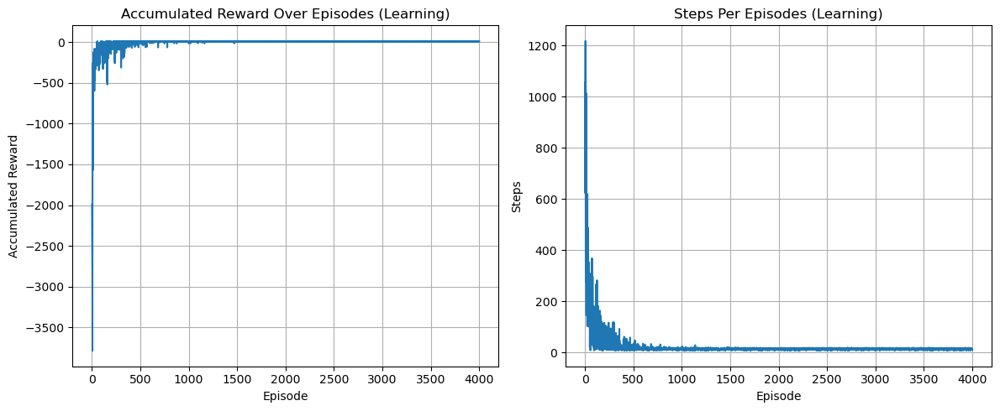

In [10]:
Q = np.zeros([n_states, n_actions])
episodes = 4001
alpha = 0.3
gamma = 0.9
epsilon = 0 
tau = 0
policy = "greedy"
update_rule = "Q-learning"

Q, rewards, steps = train(Q, episodes, alpha, gamma, epsilon, tau, policy, update_rule)

plot_results(rewards, steps)

Policy = **ε-Greedy**

ε = 0.05 

Epidsode 0 - Accumulated Reward: -1196, Steps: 389
Epidsode 200 - Accumulated Reward: -5, Steps: 26
Epidsode 400 - Accumulated Reward: 10, Steps: 11
Epidsode 600 - Accumulated Reward: 8, Steps: 13
Epidsode 800 - Accumulated Reward: 6, Steps: 15
Epidsode 1000 - Accumulated Reward: 12, Steps: 9
Epidsode 1200 - Accumulated Reward: 7, Steps: 14
Epidsode 1400 - Accumulated Reward: 3, Steps: 18
Epidsode 1600 - Accumulated Reward: 3, Steps: 18
Epidsode 1800 - Accumulated Reward: -3, Steps: 15
Epidsode 2000 - Accumulated Reward: 5, Steps: 16
Epidsode 2200 - Accumulated Reward: 3, Steps: 18
Epidsode 2400 - Accumulated Reward: 6, Steps: 15
Epidsode 2600 - Accumulated Reward: -3, Steps: 15
Epidsode 2800 - Accumulated Reward: 11, Steps: 10
Epidsode 3000 - Accumulated Reward: 5, Steps: 16
Epidsode 3200 - Accumulated Reward: 4, Steps: 17
Epidsode 3400 - Accumulated Reward: 6, Steps: 15
Epidsode 3600 - Accumulated Reward: 10, Steps: 11
Epidsode 3800 - Accumulated Reward: 2, Steps: 19
Epidsode 4000 - 

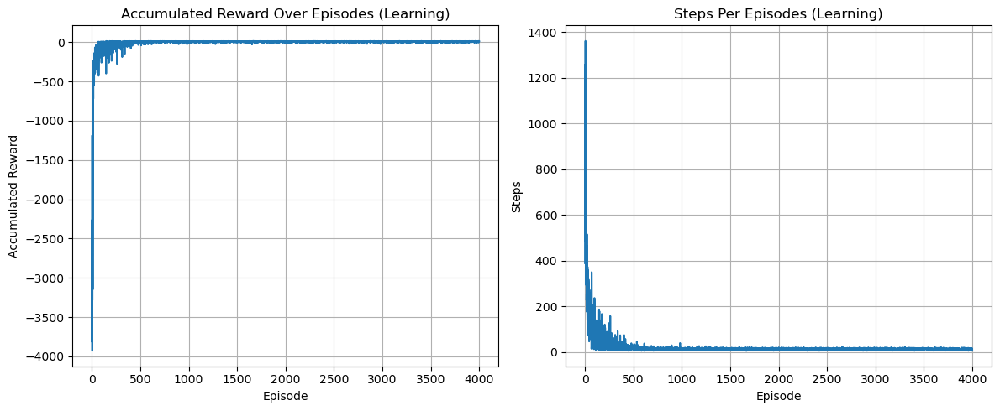

In [63]:
Q = np.zeros([n_states, n_actions])
episodes = 4001
alpha = 0.3
gamma = 0.9
epsilon = 0.05
tau = 0
policy = "epsilon_greedy"
update_rule = "Q-learning"

Q, rewards, steps = train(Q, episodes, alpha, gamma, epsilon, tau, policy, update_rule)

plot_results(rewards, steps)

ε = 0.1

Epidsode 0 - Accumulated Reward: -2283, Steps: 729
Epidsode 200 - Accumulated Reward: -77, Steps: 80
Epidsode 400 - Accumulated Reward: 8, Steps: 13
Epidsode 600 - Accumulated Reward: 4, Steps: 17
Epidsode 800 - Accumulated Reward: -8, Steps: 29
Epidsode 1000 - Accumulated Reward: 8, Steps: 13
Epidsode 1200 - Accumulated Reward: 6, Steps: 15
Epidsode 1400 - Accumulated Reward: 8, Steps: 13
Epidsode 1600 - Accumulated Reward: 8, Steps: 13
Epidsode 1800 - Accumulated Reward: -7, Steps: 10
Epidsode 2000 - Accumulated Reward: 9, Steps: 12
Epidsode 2200 - Accumulated Reward: 6, Steps: 15
Epidsode 2400 - Accumulated Reward: 8, Steps: 13
Epidsode 2600 - Accumulated Reward: 5, Steps: 16
Epidsode 2800 - Accumulated Reward: 9, Steps: 12
Epidsode 3000 - Accumulated Reward: -9, Steps: 21
Epidsode 3200 - Accumulated Reward: 0, Steps: 12
Epidsode 3400 - Accumulated Reward: 3, Steps: 18
Epidsode 3600 - Accumulated Reward: 12, Steps: 9
Epidsode 3800 - Accumulated Reward: -9, Steps: 21
Epidsode 4000 - 

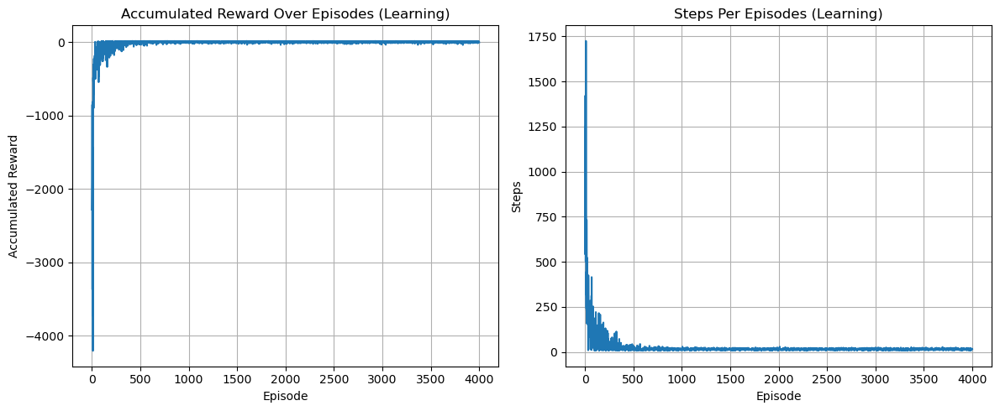

In [64]:
Q = np.zeros([n_states, n_actions])
episodes = 4001
alpha = 0.3
gamma = 0.9
epsilon = 0.1
tau = 0
policy = "epsilon_greedy"
update_rule = "Q-learning"

Q, rewards, steps = train(Q, episodes, alpha, gamma, epsilon, tau, policy, update_rule)

plot_results(rewards, steps)

ε = 0.25

Epidsode 0 - Accumulated Reward: -2500, Steps: 784
Epidsode 200 - Accumulated Reward: -167, Steps: 98
Epidsode 400 - Accumulated Reward: -59, Steps: 44
Epidsode 600 - Accumulated Reward: -16, Steps: 19
Epidsode 800 - Accumulated Reward: 3, Steps: 18
Epidsode 1000 - Accumulated Reward: -7, Steps: 10
Epidsode 1200 - Accumulated Reward: 1, Steps: 11
Epidsode 1400 - Accumulated Reward: -15, Steps: 18
Epidsode 1600 - Accumulated Reward: -2, Steps: 14
Epidsode 1800 - Accumulated Reward: 14, Steps: 7
Epidsode 2000 - Accumulated Reward: 7, Steps: 14
Epidsode 2200 - Accumulated Reward: -8, Steps: 20
Epidsode 2400 - Accumulated Reward: -3, Steps: 15
Epidsode 2600 - Accumulated Reward: -31, Steps: 25
Epidsode 2800 - Accumulated Reward: 1, Steps: 20
Epidsode 3000 - Accumulated Reward: -27, Steps: 21
Epidsode 3200 - Accumulated Reward: -9, Steps: 12
Epidsode 3400 - Accumulated Reward: 6, Steps: 15
Epidsode 3600 - Accumulated Reward: -17, Steps: 20
Epidsode 3800 - Accumulated Reward: -30, Steps: 33


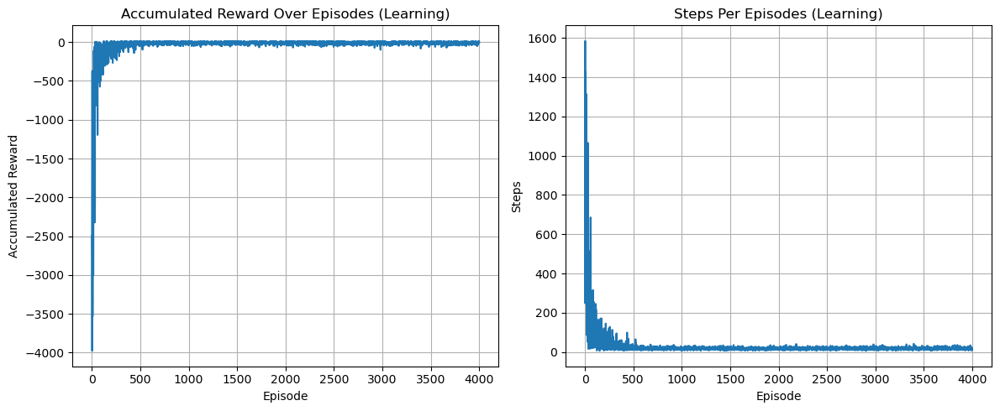

In [67]:
Q = np.zeros([n_states, n_actions])
episodes = 4001
alpha = 0.3
gamma = 0.9
epsilon = 0.25
tau = 0
policy = "epsilon_greedy"
update_rule = "Q-learning"

Q, rewards, steps = train(Q, episodes, alpha, gamma, epsilon, tau, policy, update_rule)

plot_results(rewards, steps)

ε = 0.5

Epidsode 0 - Accumulated Reward: -2750, Steps: 917
Epidsode 200 - Accumulated Reward: -154, Steps: 85
Epidsode 400 - Accumulated Reward: -119, Steps: 41
Epidsode 600 - Accumulated Reward: -44, Steps: 20
Epidsode 800 - Accumulated Reward: -52, Steps: 28
Epidsode 1000 - Accumulated Reward: -84, Steps: 42
Epidsode 1200 - Accumulated Reward: -76, Steps: 34
Epidsode 1400 - Accumulated Reward: -73, Steps: 31
Epidsode 1600 - Accumulated Reward: -106, Steps: 46
Epidsode 1800 - Accumulated Reward: -65, Steps: 32
Epidsode 2000 - Accumulated Reward: -60, Steps: 36
Epidsode 2200 - Accumulated Reward: -55, Steps: 31
Epidsode 2400 - Accumulated Reward: 0, Steps: 21
Epidsode 2600 - Accumulated Reward: -135, Steps: 48
Epidsode 2800 - Accumulated Reward: -91, Steps: 31
Epidsode 3000 - Accumulated Reward: -45, Steps: 30
Epidsode 3200 - Accumulated Reward: -5, Steps: 17
Epidsode 3400 - Accumulated Reward: -51, Steps: 18
Epidsode 3600 - Accumulated Reward: -64, Steps: 31
Epidsode 3800 - Accumulated Reward

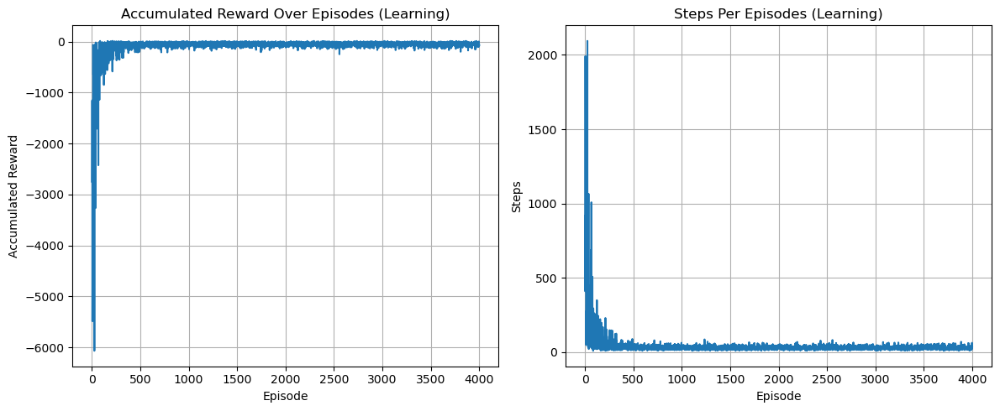

In [68]:
Q = np.zeros([n_states, n_actions])
episodes = 4001
alpha = 0.3
gamma = 0.9
epsilon = 0.5
tau = 0
policy = "epsilon_greedy"
update_rule = "Q-learning"

Q, rewards, steps = train(Q, episodes, alpha, gamma, epsilon, tau, policy, update_rule)

plot_results(rewards, steps)

The above result shows how different ε value can impact the rewards significantly. 

For ε = 0 (Greedy), training result seems to be moderately good, sugguest that the model might be stuck at a local minima. In terms of stability over the runs, this policy has the highest stability. 

For ε = 0.05 (ε-Greedy), training result seems to perform best, sugguest that the agent explores alternative actions about 5% of the time. This level of exploration appears to provide a good balance, allowing the agent to learn useful information about the environment without deviating too often from known good strategies. In terms of stability over the runs, this policy has the high stability. 

For ε >= 0.1 (ε-Greedy), training result seems to worst, the agent starts exploring alternative actions 10% or more of the time. This excessive exploration may be detrimental because the agent spends too much time trying out suboptimal actions, which can lead to less stable learning or slower convergence. In terms of stability over the runs, this policy has the lowest stability, the higher the ε value, the higher instability.

Policy = **Softmax**

$\tau$ = 0.05

Epidsode 0 - Accumulated Reward: -981, Steps: 318
Epidsode 200 - Accumulated Reward: 13, Steps: 8
Epidsode 400 - Accumulated Reward: -16, Steps: 37
Epidsode 600 - Accumulated Reward: 15, Steps: 6
Epidsode 800 - Accumulated Reward: 9, Steps: 12
Epidsode 1000 - Accumulated Reward: 3, Steps: 18
Epidsode 1200 - Accumulated Reward: 11, Steps: 10
Epidsode 1400 - Accumulated Reward: 6, Steps: 15
Epidsode 1600 - Accumulated Reward: 5, Steps: 16
Epidsode 1800 - Accumulated Reward: 10, Steps: 11
Epidsode 2000 - Accumulated Reward: 6, Steps: 15
Epidsode 2200 - Accumulated Reward: 9, Steps: 12
Epidsode 2400 - Accumulated Reward: 11, Steps: 10
Epidsode 2600 - Accumulated Reward: 9, Steps: 12
Epidsode 2800 - Accumulated Reward: 4, Steps: 17
Epidsode 3000 - Accumulated Reward: 5, Steps: 16
Epidsode 3200 - Accumulated Reward: 6, Steps: 15
Epidsode 3400 - Accumulated Reward: 5, Steps: 16
Epidsode 3600 - Accumulated Reward: 6, Steps: 15
Epidsode 3800 - Accumulated Reward: 8, Steps: 13
Epidsode 4000 - Ac

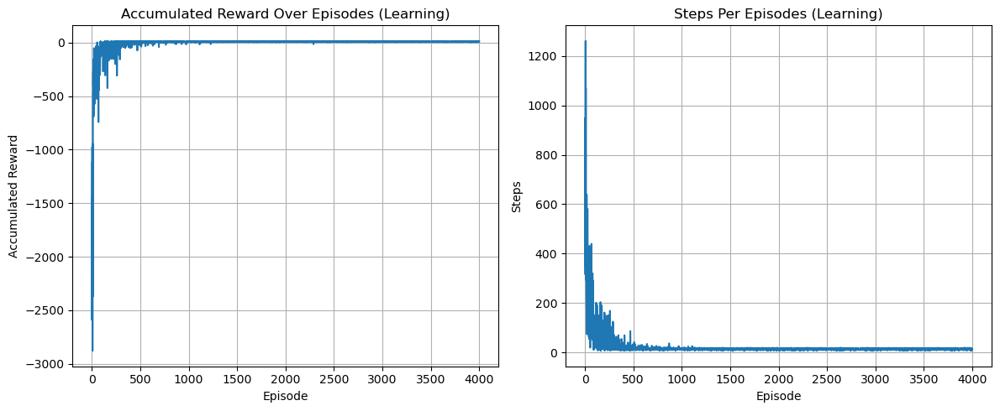

In [97]:
Q = np.zeros([n_states, n_actions])
episodes = 4001
alpha = 0.3
gamma = 0.9
epsilon = 0
tau = 0.05
policy = "softmax"
update_rule = "Q-learning"

Q, rewards, steps = train(Q, episodes, alpha, gamma, epsilon, tau, policy, update_rule)

plot_results(rewards, steps)

$\tau$ = 0.1

Epidsode 0 - Accumulated Reward: -2618, Steps: 1037
Epidsode 200 - Accumulated Reward: 6, Steps: 15
Epidsode 400 - Accumulated Reward: 3, Steps: 18
Epidsode 600 - Accumulated Reward: 13, Steps: 8
Epidsode 800 - Accumulated Reward: 14, Steps: 7
Epidsode 1000 - Accumulated Reward: 13, Steps: 8
Epidsode 1200 - Accumulated Reward: 6, Steps: 15
Epidsode 1400 - Accumulated Reward: 8, Steps: 13
Epidsode 1600 - Accumulated Reward: 10, Steps: 11
Epidsode 1800 - Accumulated Reward: 4, Steps: 17
Epidsode 2000 - Accumulated Reward: 5, Steps: 16
Epidsode 2200 - Accumulated Reward: 13, Steps: 8
Epidsode 2400 - Accumulated Reward: 5, Steps: 16
Epidsode 2600 - Accumulated Reward: 6, Steps: 15
Epidsode 2800 - Accumulated Reward: 11, Steps: 10
Epidsode 3000 - Accumulated Reward: 9, Steps: 12
Epidsode 3200 - Accumulated Reward: 8, Steps: 13
Epidsode 3400 - Accumulated Reward: 9, Steps: 12
Epidsode 3600 - Accumulated Reward: 14, Steps: 7
Epidsode 3800 - Accumulated Reward: 11, Steps: 10
Epidsode 4000 - Ac

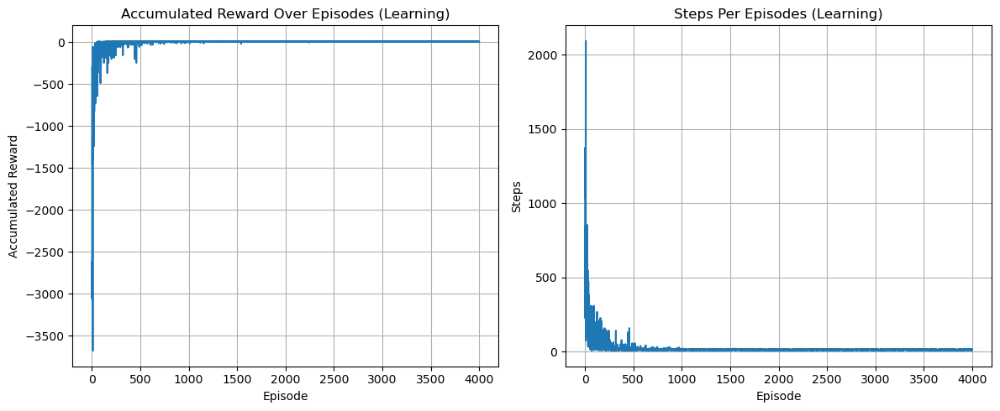

In [70]:
Q = np.zeros([n_states, n_actions])
episodes = 4001
alpha = 0.3
gamma = 0.9
epsilon = 0
tau = 0.1
policy = "softmax"
update_rule = "Q-learning"

Q, rewards, steps = train(Q, episodes, alpha, gamma, epsilon, tau, policy, update_rule)

plot_results(rewards, steps)

$\tau$ = 0.25

Epidsode 0 - Accumulated Reward: -914, Steps: 278
Epidsode 200 - Accumulated Reward: -31, Steps: 34
Epidsode 400 - Accumulated Reward: -5, Steps: 26
Epidsode 600 - Accumulated Reward: 13, Steps: 8
Epidsode 800 - Accumulated Reward: 7, Steps: 14
Epidsode 1000 - Accumulated Reward: 11, Steps: 10
Epidsode 1200 - Accumulated Reward: -4, Steps: 25
Epidsode 1400 - Accumulated Reward: 6, Steps: 15
Epidsode 1600 - Accumulated Reward: 6, Steps: 15
Epidsode 1800 - Accumulated Reward: 7, Steps: 14
Epidsode 2000 - Accumulated Reward: 5, Steps: 16
Epidsode 2200 - Accumulated Reward: 8, Steps: 13
Epidsode 2400 - Accumulated Reward: 10, Steps: 11
Epidsode 2600 - Accumulated Reward: 5, Steps: 16
Epidsode 2800 - Accumulated Reward: 6, Steps: 15
Epidsode 3000 - Accumulated Reward: 9, Steps: 12
Epidsode 3200 - Accumulated Reward: 10, Steps: 11
Epidsode 3400 - Accumulated Reward: 7, Steps: 14
Epidsode 3600 - Accumulated Reward: 8, Steps: 13
Epidsode 3800 - Accumulated Reward: 7, Steps: 14
Epidsode 4000 - 

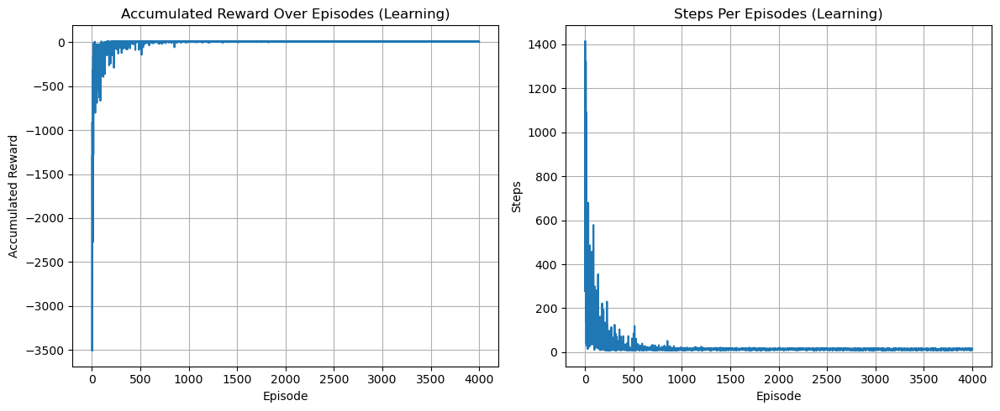

In [75]:
Q = np.zeros([n_states, n_actions])
episodes = 4001
alpha = 0.3
gamma = 0.9
epsilon = 0
tau = 0.25
policy = "softmax"
update_rule = "Q-learning"

Q, rewards, steps = train(Q, episodes, alpha, gamma, epsilon, tau, policy, update_rule)

plot_results(rewards, steps)

$\tau$ = 0.5

Epidsode 0 - Accumulated Reward: -559, Steps: 175
Epidsode 200 - Accumulated Reward: -95, Steps: 98
Epidsode 400 - Accumulated Reward: 10, Steps: 11
Epidsode 600 - Accumulated Reward: 11, Steps: 10
Epidsode 800 - Accumulated Reward: 13, Steps: 8
Epidsode 1000 - Accumulated Reward: 6, Steps: 15
Epidsode 1200 - Accumulated Reward: 6, Steps: 15
Epidsode 1400 - Accumulated Reward: 6, Steps: 15
Epidsode 1600 - Accumulated Reward: 9, Steps: 12
Epidsode 1800 - Accumulated Reward: 14, Steps: 7
Epidsode 2000 - Accumulated Reward: 6, Steps: 15
Epidsode 2200 - Accumulated Reward: 9, Steps: 12
Epidsode 2400 - Accumulated Reward: 14, Steps: 7
Epidsode 2600 - Accumulated Reward: 9, Steps: 12
Epidsode 2800 - Accumulated Reward: 7, Steps: 14
Epidsode 3000 - Accumulated Reward: 4, Steps: 17
Epidsode 3200 - Accumulated Reward: 8, Steps: 13
Epidsode 3400 - Accumulated Reward: 8, Steps: 13
Epidsode 3600 - Accumulated Reward: 12, Steps: 9
Epidsode 3800 - Accumulated Reward: 10, Steps: 11
Epidsode 4000 - Ac

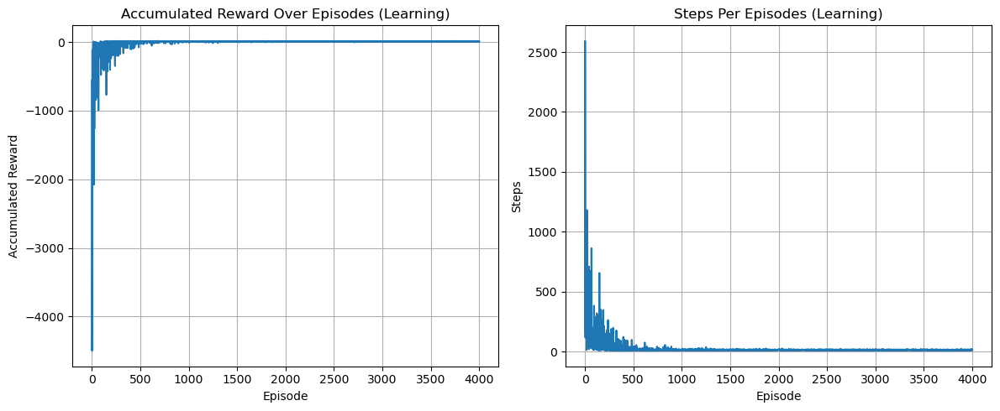

In [77]:
Q = np.zeros([n_states, n_actions])
episodes = 4001
alpha = 0.3
gamma = 0.9
epsilon = 0
tau = 0.5
policy = "softmax"
update_rule = "Q-learning"

Q, rewards, steps = train(Q, episodes, alpha, gamma, epsilon, tau, policy, update_rule)
        
plot_results(rewards, steps)

$\tau$ = 0.75

Epidsode 0 - Accumulated Reward: -1647, Steps: 723
Epidsode 200 - Accumulated Reward: -91, Steps: 103
Epidsode 400 - Accumulated Reward: -131, Steps: 125
Epidsode 600 - Accumulated Reward: 8, Steps: 13
Epidsode 800 - Accumulated Reward: 5, Steps: 16
Epidsode 1000 - Accumulated Reward: 9, Steps: 12
Epidsode 1200 - Accumulated Reward: 4, Steps: 17
Epidsode 1400 - Accumulated Reward: 8, Steps: 13
Epidsode 1600 - Accumulated Reward: 6, Steps: 15
Epidsode 1800 - Accumulated Reward: 9, Steps: 12
Epidsode 2000 - Accumulated Reward: 9, Steps: 12
Epidsode 2200 - Accumulated Reward: 9, Steps: 12
Epidsode 2400 - Accumulated Reward: 7, Steps: 14
Epidsode 2600 - Accumulated Reward: 11, Steps: 10
Epidsode 2800 - Accumulated Reward: 11, Steps: 10
Epidsode 3000 - Accumulated Reward: 2, Steps: 19
Epidsode 3200 - Accumulated Reward: 10, Steps: 11
Epidsode 3400 - Accumulated Reward: 9, Steps: 12
Epidsode 3600 - Accumulated Reward: 9, Steps: 12
Epidsode 3800 - Accumulated Reward: 8, Steps: 13
Epidsode 400

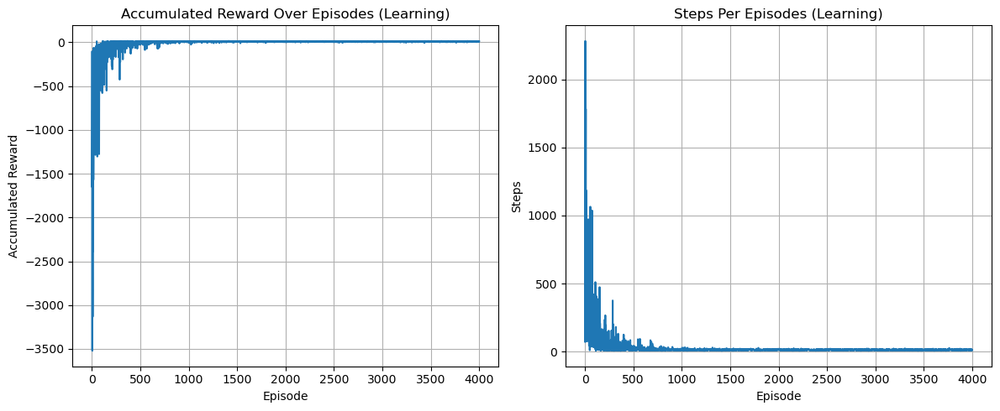

In [80]:
Q = np.zeros([n_states, n_actions])
episodes = 4001
alpha = 0.3
gamma = 0.9
epsilon = 0
tau = 0.75
policy = "softmax"
update_rule = "Q-learning"

Q, rewards, steps = train(Q, episodes, alpha, gamma, epsilon, tau, policy, update_rule)

plot_results(rewards, steps)

As we can see form the above results using Softmax policy, the overall perforamce in terms of rewards are higher than ε-Greedy.

For lower $\tau$ value, we can observe higher stability, wise versa.

#### Update Rule = **SARSA**

Policy = **Greedy**

Epidsode 0 - Accumulated Reward: -3801, Steps: 1230
Epidsode 200 - Accumulated Reward: -153, Steps: 174
Epidsode 400 - Accumulated Reward: 10, Steps: 11
Epidsode 600 - Accumulated Reward: -4, Steps: 25
Epidsode 800 - Accumulated Reward: 9, Steps: 12
Epidsode 1000 - Accumulated Reward: 13, Steps: 8
Epidsode 1200 - Accumulated Reward: 5, Steps: 16
Epidsode 1400 - Accumulated Reward: 3, Steps: 18
Epidsode 1600 - Accumulated Reward: 8, Steps: 13
Epidsode 1800 - Accumulated Reward: 8, Steps: 13
Epidsode 2000 - Accumulated Reward: 10, Steps: 11
Epidsode 2200 - Accumulated Reward: 5, Steps: 16
Epidsode 2400 - Accumulated Reward: 8, Steps: 13
Epidsode 2600 - Accumulated Reward: 9, Steps: 12
Epidsode 2800 - Accumulated Reward: 8, Steps: 13
Epidsode 3000 - Accumulated Reward: 8, Steps: 13
Epidsode 3200 - Accumulated Reward: 3, Steps: 18
Epidsode 3400 - Accumulated Reward: 8, Steps: 13
Epidsode 3600 - Accumulated Reward: 4, Steps: 17
Epidsode 3800 - Accumulated Reward: 9, Steps: 12
Epidsode 4000 

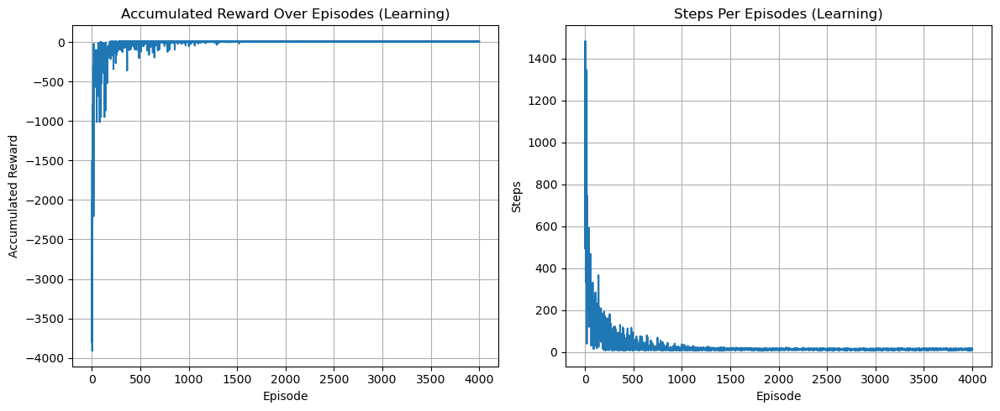

In [81]:
Q = np.zeros([n_states, n_actions])
episodes = 4001
alpha = 0.15
gamma = 0.9
epsilon = 0 
tau = 0
policy = "greedy"
update_rule = "SARSA"

Q, rewards, steps = train(Q, episodes, alpha, gamma, epsilon, tau, policy, update_rule)

plot_results(rewards, steps)

Policy = **ε-Greedy**

ε = 0.05

Epidsode 0 - Accumulated Reward: -3813, Steps: 1332
Epidsode 200 - Accumulated Reward: -34, Steps: 55
Epidsode 400 - Accumulated Reward: 11, Steps: 10
Epidsode 600 - Accumulated Reward: -15, Steps: 27
Epidsode 800 - Accumulated Reward: 0, Steps: 21
Epidsode 1000 - Accumulated Reward: -28, Steps: 40
Epidsode 1200 - Accumulated Reward: 4, Steps: 17
Epidsode 1400 - Accumulated Reward: 8, Steps: 13
Epidsode 1600 - Accumulated Reward: 14, Steps: 7
Epidsode 1800 - Accumulated Reward: 8, Steps: 13
Epidsode 2000 - Accumulated Reward: -3, Steps: 15
Epidsode 2200 - Accumulated Reward: -1, Steps: 13
Epidsode 2400 - Accumulated Reward: 7, Steps: 14
Epidsode 2600 - Accumulated Reward: 7, Steps: 14
Epidsode 2800 - Accumulated Reward: 10, Steps: 11
Epidsode 3000 - Accumulated Reward: 0, Steps: 12
Epidsode 3200 - Accumulated Reward: 4, Steps: 17
Epidsode 3400 - Accumulated Reward: 6, Steps: 15
Epidsode 3600 - Accumulated Reward: 7, Steps: 14
Epidsode 3800 - Accumulated Reward: 3, Steps: 18
Epidsode 40

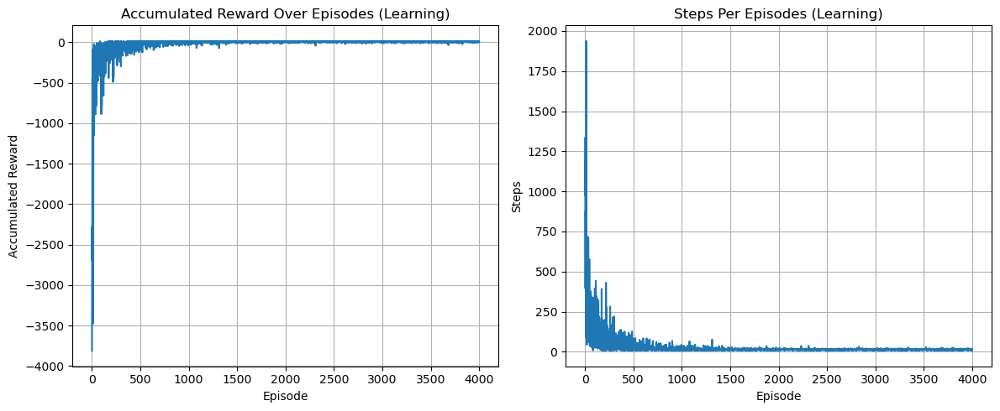

In [82]:
Q = np.zeros([n_states, n_actions])
episodes = 4001
alpha = 0.15
gamma = 0.9
epsilon = 0.05
tau = 0
policy = "epsilon_greedy"
update_rule = "SARSA"

Q, rewards, steps = train(Q, episodes, alpha, gamma, epsilon, tau, policy, update_rule)

plot_results(rewards, steps)

ε = 0.1

Epidsode 0 - Accumulated Reward: -2488, Steps: 835
Epidsode 200 - Accumulated Reward: -47, Steps: 41
Epidsode 400 - Accumulated Reward: -12, Steps: 15
Epidsode 600 - Accumulated Reward: 2, Steps: 19
Epidsode 800 - Accumulated Reward: -1, Steps: 13
Epidsode 1000 - Accumulated Reward: 1, Steps: 20
Epidsode 1200 - Accumulated Reward: -7, Steps: 28
Epidsode 1400 - Accumulated Reward: -4, Steps: 16
Epidsode 1600 - Accumulated Reward: -8, Steps: 20
Epidsode 1800 - Accumulated Reward: 11, Steps: 10
Epidsode 2000 - Accumulated Reward: 6, Steps: 15
Epidsode 2200 - Accumulated Reward: 12, Steps: 9
Epidsode 2400 - Accumulated Reward: 4, Steps: 17
Epidsode 2600 - Accumulated Reward: -21, Steps: 15
Epidsode 2800 - Accumulated Reward: 11, Steps: 10
Epidsode 3000 - Accumulated Reward: 2, Steps: 19
Epidsode 3200 - Accumulated Reward: 5, Steps: 16
Epidsode 3400 - Accumulated Reward: 6, Steps: 15
Epidsode 3600 - Accumulated Reward: -6, Steps: 18
Epidsode 3800 - Accumulated Reward: 1, Steps: 20
Epidsode 

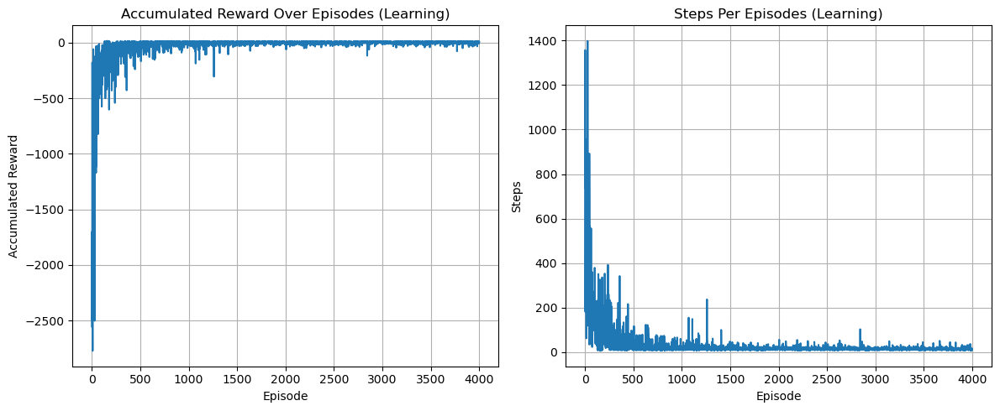

In [83]:
Q = np.zeros([n_states, n_actions])
episodes = 4001
alpha = 0.15
gamma = 0.9
epsilon = 0.1
tau = 0
policy = "epsilon_greedy"
update_rule = "SARSA"

Q, rewards, steps = train(Q, episodes, alpha, gamma, epsilon, tau, policy, update_rule)

plot_results(rewards, steps)

As we can see from the above result, SARSA is very sensitive the the value of ε, meaning higher instability than Q-learning. With ε = 0 (Greedy), the learning seems more stable.

Policy = **Softmax**

$\tau$ = 0.05

Epidsode 0 - Accumulated Reward: -1727, Steps: 587
Epidsode 200 - Accumulated Reward: -113, Steps: 98
Epidsode 400 - Accumulated Reward: 7, Steps: 14
Epidsode 600 - Accumulated Reward: 8, Steps: 13
Epidsode 800 - Accumulated Reward: 7, Steps: 14
Epidsode 1000 - Accumulated Reward: 10, Steps: 11
Epidsode 1200 - Accumulated Reward: 13, Steps: 8
Epidsode 1400 - Accumulated Reward: 8, Steps: 13
Epidsode 1600 - Accumulated Reward: 6, Steps: 15
Epidsode 1800 - Accumulated Reward: 6, Steps: 15
Epidsode 2000 - Accumulated Reward: 11, Steps: 10
Epidsode 2200 - Accumulated Reward: 9, Steps: 12
Epidsode 2400 - Accumulated Reward: 8, Steps: 13
Epidsode 2600 - Accumulated Reward: 11, Steps: 10
Epidsode 2800 - Accumulated Reward: 5, Steps: 16
Epidsode 3000 - Accumulated Reward: 5, Steps: 16
Epidsode 3200 - Accumulated Reward: 4, Steps: 17
Epidsode 3400 - Accumulated Reward: 8, Steps: 13
Epidsode 3600 - Accumulated Reward: 10, Steps: 11
Epidsode 3800 - Accumulated Reward: 9, Steps: 12
Epidsode 4000 -

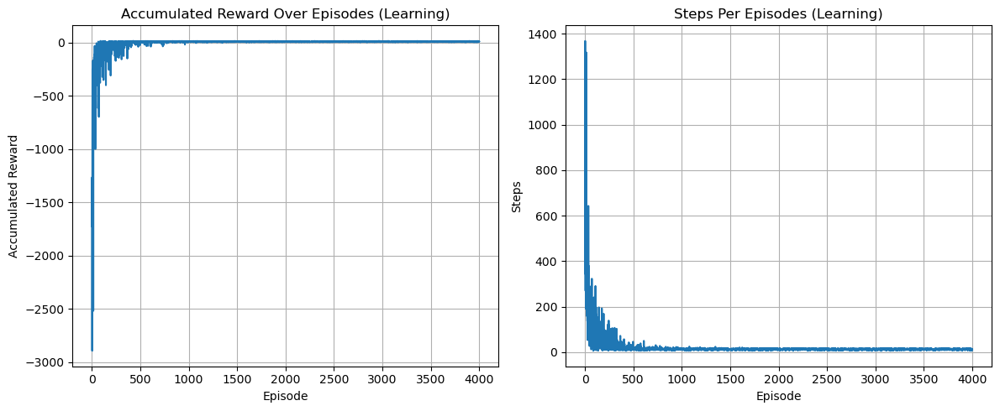

In [84]:
Q = np.zeros([n_states, n_actions])
episodes = 4001
alpha = 0.3
gamma = 0.9
epsilon = 0
tau = 0.05
policy = "softmax"
update_rule = "SARSA"

Q, rewards, steps = train(Q, episodes, alpha, gamma, epsilon, tau, policy, update_rule)

plot_results(rewards, steps)

$\tau$ = 0.1

Epidsode 0 - Accumulated Reward: -2712, Steps: 1041
Epidsode 200 - Accumulated Reward: 0, Steps: 21
Epidsode 400 - Accumulated Reward: 12, Steps: 9
Epidsode 600 - Accumulated Reward: 5, Steps: 16
Epidsode 800 - Accumulated Reward: 13, Steps: 8
Epidsode 1000 - Accumulated Reward: 11, Steps: 10
Epidsode 1200 - Accumulated Reward: 9, Steps: 12
Epidsode 1400 - Accumulated Reward: 6, Steps: 15
Epidsode 1600 - Accumulated Reward: 5, Steps: 16
Epidsode 1800 - Accumulated Reward: 3, Steps: 18
Epidsode 2000 - Accumulated Reward: 6, Steps: 15
Epidsode 2200 - Accumulated Reward: 4, Steps: 17
Epidsode 2400 - Accumulated Reward: 4, Steps: 17
Epidsode 2600 - Accumulated Reward: 10, Steps: 11
Epidsode 2800 - Accumulated Reward: 13, Steps: 8
Epidsode 3000 - Accumulated Reward: 8, Steps: 13
Epidsode 3200 - Accumulated Reward: 6, Steps: 15
Epidsode 3400 - Accumulated Reward: 6, Steps: 15
Epidsode 3600 - Accumulated Reward: 6, Steps: 15
Epidsode 3800 - Accumulated Reward: 11, Steps: 10
Epidsode 4000 - Ac

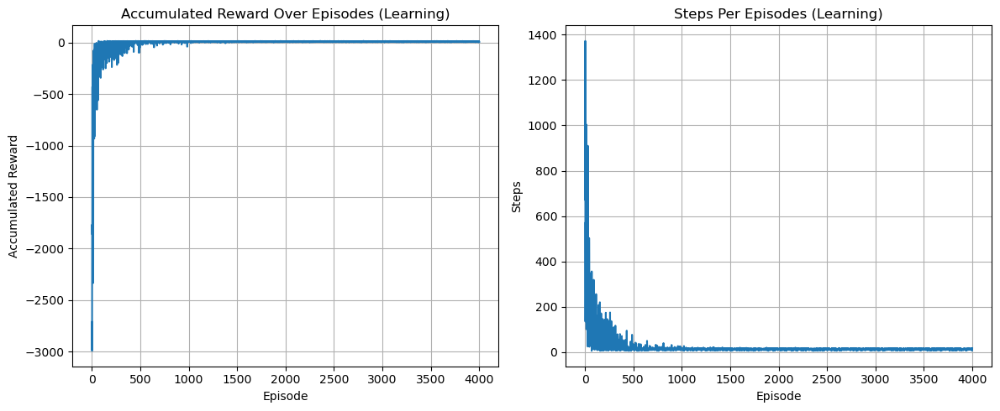

In [87]:
Q = np.zeros([n_states, n_actions])
episodes = 4001
alpha = 0.3
gamma = 0.9
epsilon = 0
tau = 0.1
policy = "softmax"
update_rule = "SARSA"

Q, rewards, steps = train(Q, episodes, alpha, gamma, epsilon, tau, policy, update_rule)

plot_results(rewards, steps)

$\tau$ = 0.25

Epidsode 0 - Accumulated Reward: -270, Steps: 102
Epidsode 200 - Accumulated Reward: -45, Steps: 66
Epidsode 400 - Accumulated Reward: -52, Steps: 37
Epidsode 600 - Accumulated Reward: 5, Steps: 16
Epidsode 800 - Accumulated Reward: 10, Steps: 11
Epidsode 1000 - Accumulated Reward: 13, Steps: 8
Epidsode 1200 - Accumulated Reward: 12, Steps: 9
Epidsode 1400 - Accumulated Reward: 10, Steps: 11
Epidsode 1600 - Accumulated Reward: 8, Steps: 13
Epidsode 1800 - Accumulated Reward: 5, Steps: 16
Epidsode 2000 - Accumulated Reward: 11, Steps: 10
Epidsode 2200 - Accumulated Reward: 9, Steps: 12
Epidsode 2400 - Accumulated Reward: 3, Steps: 18
Epidsode 2600 - Accumulated Reward: 7, Steps: 14
Epidsode 2800 - Accumulated Reward: 8, Steps: 13
Epidsode 3000 - Accumulated Reward: 11, Steps: 10
Epidsode 3200 - Accumulated Reward: 5, Steps: 16
Epidsode 3400 - Accumulated Reward: 5, Steps: 16
Epidsode 3600 - Accumulated Reward: 5, Steps: 16
Epidsode 3800 - Accumulated Reward: 9, Steps: 12
Epidsode 4000 -

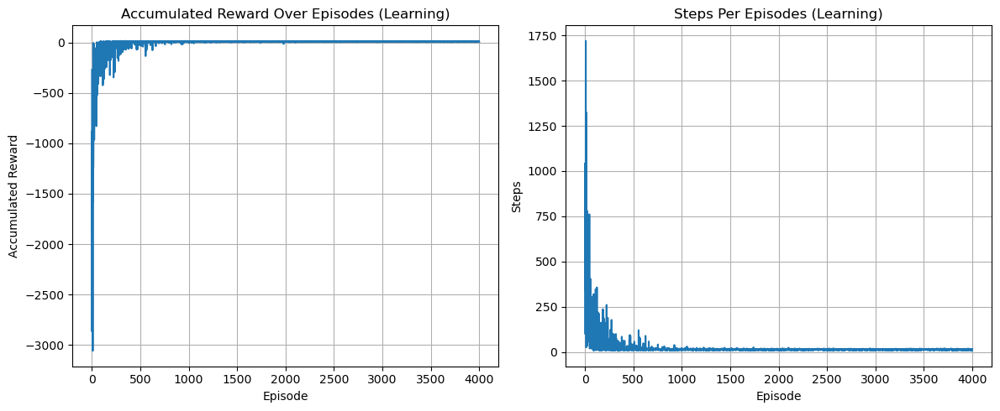

In [88]:
Q = np.zeros([n_states, n_actions])
episodes = 4001
alpha = 0.3
gamma = 0.9
epsilon = 0
tau = 0.25
policy = "softmax"
update_rule = "SARSA"

Q, rewards, steps = train(Q, episodes, alpha, gamma, epsilon, tau, policy, update_rule)
   
plot_results(rewards, steps)

$\tau$ = 0.5

Epidsode 0 - Accumulated Reward: -495, Steps: 183
Epidsode 200 - Accumulated Reward: -262, Steps: 256
Epidsode 400 - Accumulated Reward: 13, Steps: 8
Epidsode 600 - Accumulated Reward: 8, Steps: 13
Epidsode 800 - Accumulated Reward: 8, Steps: 13
Epidsode 1000 - Accumulated Reward: 6, Steps: 15
Epidsode 1200 - Accumulated Reward: 9, Steps: 12
Epidsode 1400 - Accumulated Reward: 8, Steps: 13
Epidsode 1600 - Accumulated Reward: 10, Steps: 11
Epidsode 1800 - Accumulated Reward: 12, Steps: 9
Epidsode 2000 - Accumulated Reward: 5, Steps: 16
Epidsode 2200 - Accumulated Reward: 13, Steps: 8
Epidsode 2400 - Accumulated Reward: 5, Steps: 16
Epidsode 2600 - Accumulated Reward: 7, Steps: 14
Epidsode 2800 - Accumulated Reward: 8, Steps: 13
Epidsode 3000 - Accumulated Reward: 8, Steps: 13
Epidsode 3200 - Accumulated Reward: 8, Steps: 13
Epidsode 3400 - Accumulated Reward: 8, Steps: 13
Epidsode 3600 - Accumulated Reward: 9, Steps: 12
Epidsode 3800 - Accumulated Reward: 8, Steps: 13
Epidsode 4000 - Ac

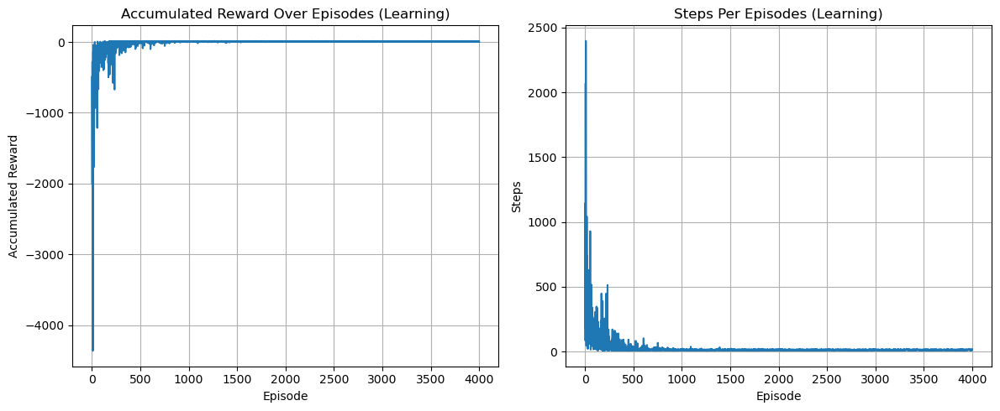

In [98]:
Q = np.zeros([n_states, n_actions])
episodes = 4001
alpha = 0.3
gamma = 0.9
epsilon = 0
tau = 0.5
policy = "softmax"
update_rule = "SARSA"

Q, rewards, steps = train(Q, episodes, alpha, gamma, epsilon, tau, policy, update_rule)
 
plot_results(rewards, steps)

$\tau$ = 0.75

Epidsode 0 - Accumulated Reward: -1331, Steps: 560
Epidsode 200 - Accumulated Reward: 9, Steps: 12
Epidsode 400 - Accumulated Reward: 9, Steps: 12
Epidsode 600 - Accumulated Reward: 6, Steps: 15
Epidsode 800 - Accumulated Reward: 8, Steps: 13
Epidsode 1000 - Accumulated Reward: 5, Steps: 16
Epidsode 1200 - Accumulated Reward: 8, Steps: 13
Epidsode 1400 - Accumulated Reward: 8, Steps: 13
Epidsode 1600 - Accumulated Reward: 8, Steps: 13
Epidsode 1800 - Accumulated Reward: 10, Steps: 11
Epidsode 2000 - Accumulated Reward: 8, Steps: 13
Epidsode 2200 - Accumulated Reward: 6, Steps: 15
Epidsode 2400 - Accumulated Reward: 5, Steps: 16
Epidsode 2600 - Accumulated Reward: 8, Steps: 13
Epidsode 2800 - Accumulated Reward: 4, Steps: 17
Epidsode 3000 - Accumulated Reward: 4, Steps: 17
Epidsode 3200 - Accumulated Reward: 8, Steps: 13
Epidsode 3400 - Accumulated Reward: 13, Steps: 8
Epidsode 3600 - Accumulated Reward: 10, Steps: 11
Epidsode 3800 - Accumulated Reward: 7, Steps: 14
Epidsode 4000 - Accu

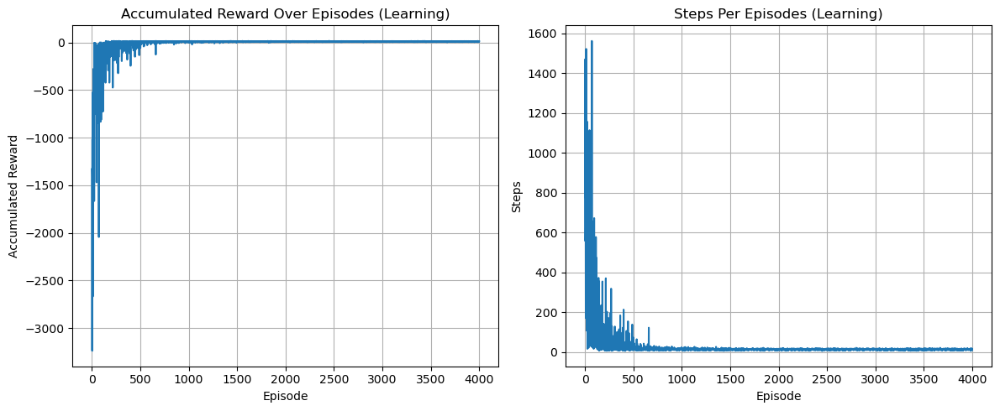

In [92]:
Q = np.zeros([n_states, n_actions])
episodes = 4001
alpha = 0.3
gamma = 0.9
epsilon = 0
tau = 0.75
policy = "softmax"
update_rule = "SARSA"

Q, rewards, steps = train(Q, episodes, alpha, gamma, epsilon, tau, policy, update_rule)
 
plot_results(rewards, steps)

Again, Softmax gives overall better results than ε-Greedy. 

Moreover, the results above also suggests the higher the $\tau$ value, the more instability during training.

### Conclusion

After experimenting with different policies for each update rules, we can say that softmax tends to offer better performance than ε-Greedy.

Higher ε / $\tau$ -> higher instability.

Performance of Q-learning and SARSA are similar with softmax as the action selection policy.

Performance of Q-learning is better than SARSA with ε-Greedy as SARSA seems more sensitive to the ε.

Softmax tends to have better results than ε-Greedy in general due to the action selection mechanisum:
- The problem with ε-Greedy is that, when it chooses the random actions, it considers all actions equally good (uniform distribution), even though certain actions are worse than others (eg. illegal pick-up or drop-off).

- Softmax on the other hand selects the random actions with probabilities proportional to their current values, hence prioritise actions that can lead to better value.

### Testing

From the above results, for both Q-Learning and SARSA action selection policies, we observed that using softmax offers the overall better performance in both cumulative rewards and average steps taken. In addition, $\tau$ at 25% can lead to moderate instability during early training. However, it converge after 2000 episodes and became stabilised.

Thus, I think it is appropriate to employ a $\tau$ value at 25% with a high number of episodes to ensure the agent gets to explore more options and still have enough epiodes to converge during training.

Training for **Q-learning** algorithm with **softmax**:

Epidsode 0 - Accumulated Reward: -2878, Steps: 1324
Epidsode 200 - Accumulated Reward: -37, Steps: 31
Epidsode 400 - Accumulated Reward: -3, Steps: 24
Epidsode 600 - Accumulated Reward: 9, Steps: 12
Epidsode 800 - Accumulated Reward: -9, Steps: 30
Epidsode 1000 - Accumulated Reward: 10, Steps: 11
Epidsode 1200 - Accumulated Reward: 7, Steps: 14
Epidsode 1400 - Accumulated Reward: 8, Steps: 13
Epidsode 1600 - Accumulated Reward: 10, Steps: 11
Epidsode 1800 - Accumulated Reward: 5, Steps: 16
Epidsode 2000 - Accumulated Reward: 7, Steps: 14
Epidsode 2200 - Accumulated Reward: 7, Steps: 14
Epidsode 2400 - Accumulated Reward: 10, Steps: 11
Epidsode 2600 - Accumulated Reward: 8, Steps: 13
Epidsode 2800 - Accumulated Reward: 4, Steps: 17
Epidsode 3000 - Accumulated Reward: 10, Steps: 11
Epidsode 3200 - Accumulated Reward: 7, Steps: 14
Epidsode 3400 - Accumulated Reward: 8, Steps: 13
Epidsode 3600 - Accumulated Reward: 7, Steps: 14
Epidsode 3800 - Accumulated Reward: 6, Steps: 15
Epidsode 4000

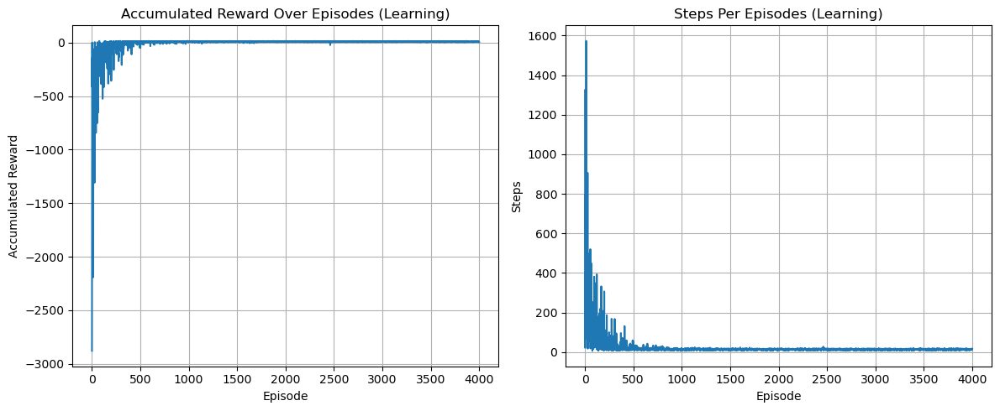

In [125]:
Q = np.zeros([n_states, n_actions])
episodes = 4001
alpha = 0.3
gamma = 0.9
epsilon = 0
tau = 0.25
policy = "softmax"
update_rule = "Q-learning"

Q_QLEARNING, rewards, steps = train(Q, episodes, alpha, gamma, epsilon, tau, policy, update_rule)
np.save('q_learning_q_table.npy', Q_QLEARNING)
plot_results(rewards, steps)

#### Visualize the trained agent for Q-Learning


In [8]:
action_descriptions = {
    0: "South",
    1: "North",
    2: "East",
    3: "West",
    4: "Pickup",
    5: "Dropoff"
} 

def visualize_agent(env, Q):
    state = env.reset()[0]
    total_reward = 0
    for step in range(100):
        # Select action using the policy derived from Q
        action = np.argmax(Q[state])
        state, reward, done, _, _ = env.step(action)
        total_reward += reward
        rendered_env = env.render() 
        plt.imshow(rendered_env)
        plt.show()
        if step != 0:
            print(f"({action_descriptions[action]})")
        print("Step:", step)
        print("State:", state, ", Action:", action, ", Reward:", reward, ", Total Accumulateed Reward:", total_reward)
        if done:
            break

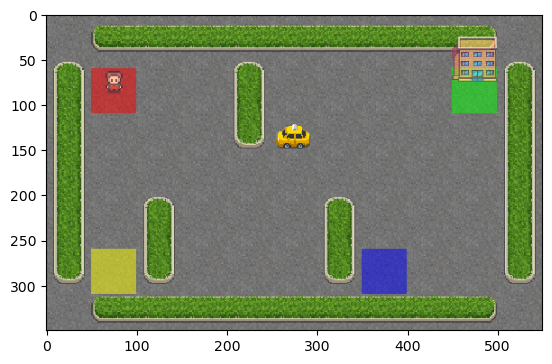

Step: 0
State: 141 , Action: 3 , Reward: -1 , Total Accumulateed Reward: -1


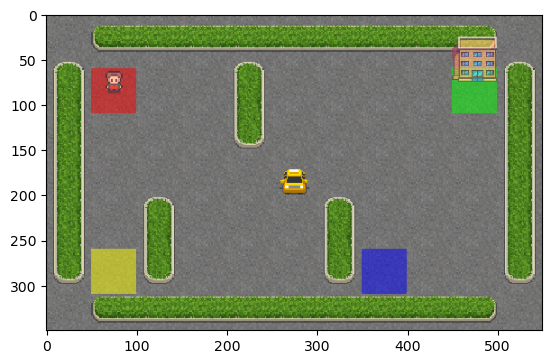

(South)
Step: 1
State: 241 , Action: 0 , Reward: -1 , Total Accumulateed Reward: -2


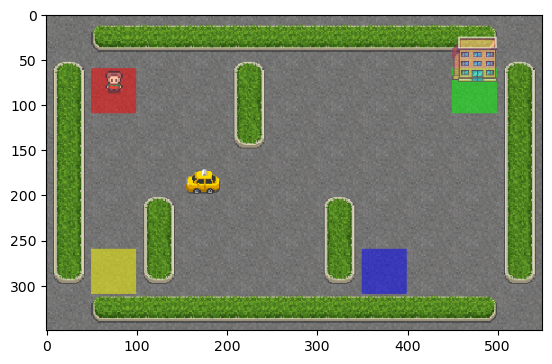

(West)
Step: 2
State: 221 , Action: 3 , Reward: -1 , Total Accumulateed Reward: -3


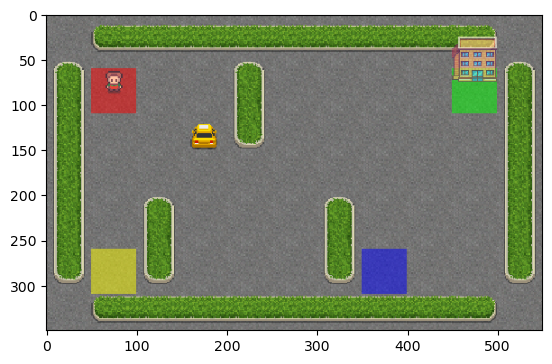

(North)
Step: 3
State: 121 , Action: 1 , Reward: -1 , Total Accumulateed Reward: -4


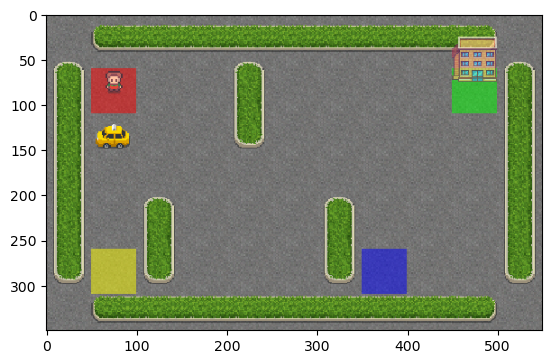

(West)
Step: 4
State: 101 , Action: 3 , Reward: -1 , Total Accumulateed Reward: -5


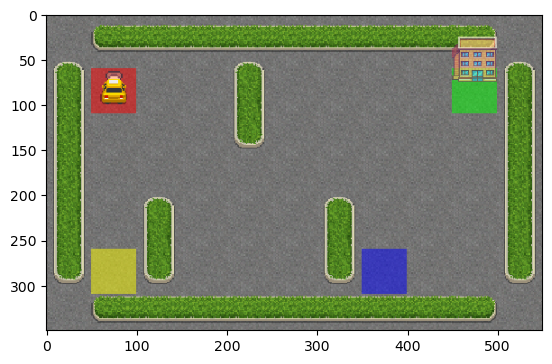

(North)
Step: 5
State: 1 , Action: 1 , Reward: -1 , Total Accumulateed Reward: -6


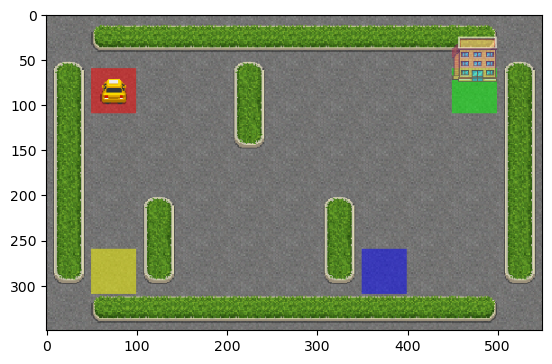

(Pickup)
Step: 6
State: 17 , Action: 4 , Reward: -1 , Total Accumulateed Reward: -7


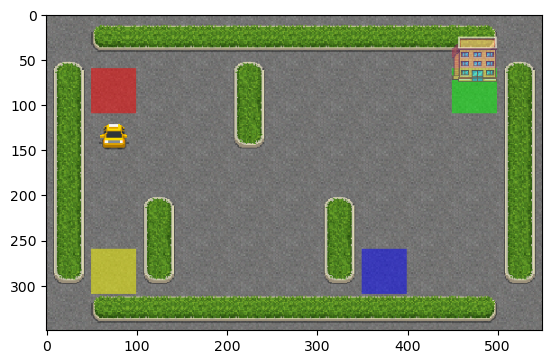

(South)
Step: 7
State: 117 , Action: 0 , Reward: -1 , Total Accumulateed Reward: -8


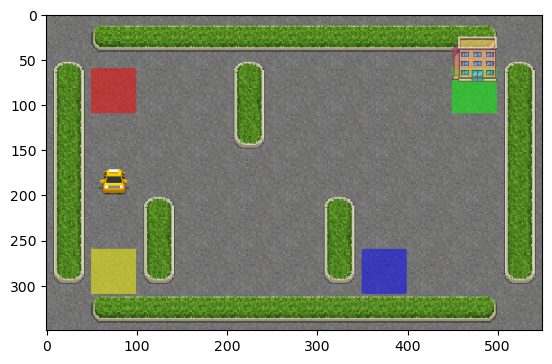

(South)
Step: 8
State: 217 , Action: 0 , Reward: -1 , Total Accumulateed Reward: -9


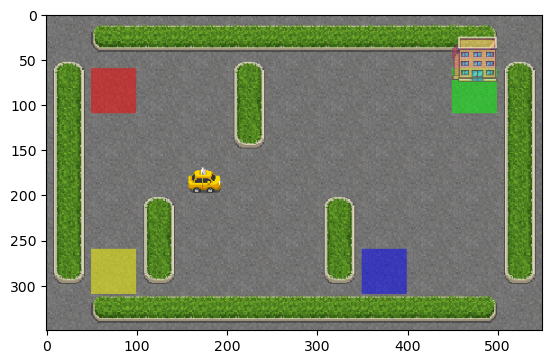

(East)
Step: 9
State: 237 , Action: 2 , Reward: -1 , Total Accumulateed Reward: -10


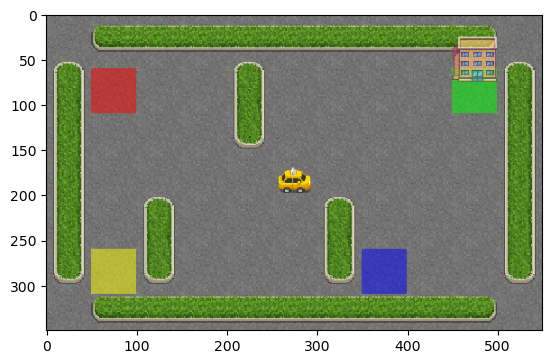

(East)
Step: 10
State: 257 , Action: 2 , Reward: -1 , Total Accumulateed Reward: -11


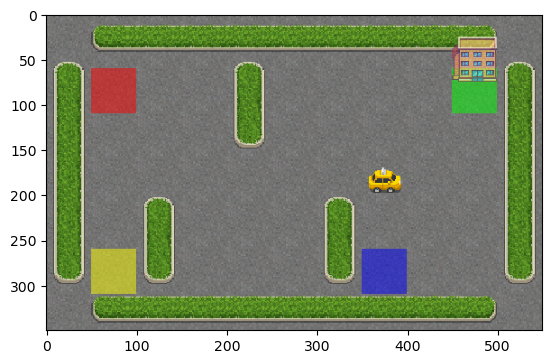

(East)
Step: 11
State: 277 , Action: 2 , Reward: -1 , Total Accumulateed Reward: -12


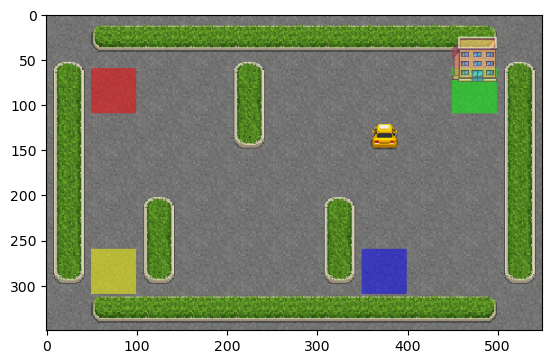

(North)
Step: 12
State: 177 , Action: 1 , Reward: -1 , Total Accumulateed Reward: -13


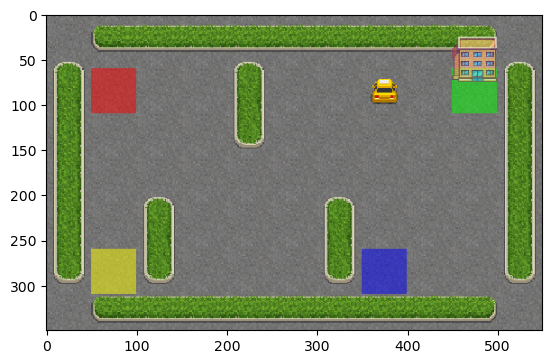

(North)
Step: 13
State: 77 , Action: 1 , Reward: -1 , Total Accumulateed Reward: -14


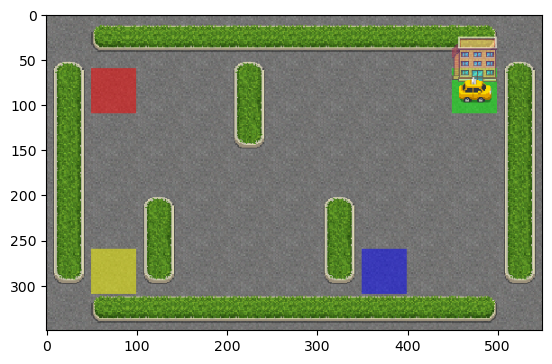

(East)
Step: 14
State: 97 , Action: 2 , Reward: -1 , Total Accumulateed Reward: -15


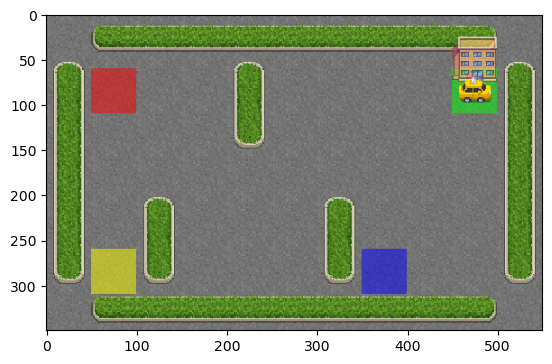

(Dropoff)
Step: 15
State: 85 , Action: 5 , Reward: 20 , Total Accumulateed Reward: 5


In [14]:
env = gym.make("Taxi-v3", render_mode="rgb_array")
visualize_agent(env, Q_QLEARNING)

Training for **SARSA** algorithm with **softmax**:

Epidsode 0 - Accumulated Reward: -1258, Steps: 469
Epidsode 200 - Accumulated Reward: -70, Steps: 55
Epidsode 400 - Accumulated Reward: 7, Steps: 14
Epidsode 600 - Accumulated Reward: 5, Steps: 16
Epidsode 800 - Accumulated Reward: 7, Steps: 14
Epidsode 1000 - Accumulated Reward: 5, Steps: 16
Epidsode 1200 - Accumulated Reward: 7, Steps: 14
Epidsode 1400 - Accumulated Reward: 10, Steps: 11
Epidsode 1600 - Accumulated Reward: 5, Steps: 16
Epidsode 1800 - Accumulated Reward: 9, Steps: 12
Epidsode 2000 - Accumulated Reward: 11, Steps: 10
Epidsode 2200 - Accumulated Reward: 4, Steps: 17
Epidsode 2400 - Accumulated Reward: 4, Steps: 17
Epidsode 2600 - Accumulated Reward: 13, Steps: 8
Epidsode 2800 - Accumulated Reward: 7, Steps: 14
Epidsode 3000 - Accumulated Reward: 6, Steps: 15
Epidsode 3200 - Accumulated Reward: 7, Steps: 14
Epidsode 3400 - Accumulated Reward: 4, Steps: 17
Epidsode 3600 - Accumulated Reward: 7, Steps: 14
Epidsode 3800 - Accumulated Reward: 3, Steps: 18
Epidsode 4000 - Ac

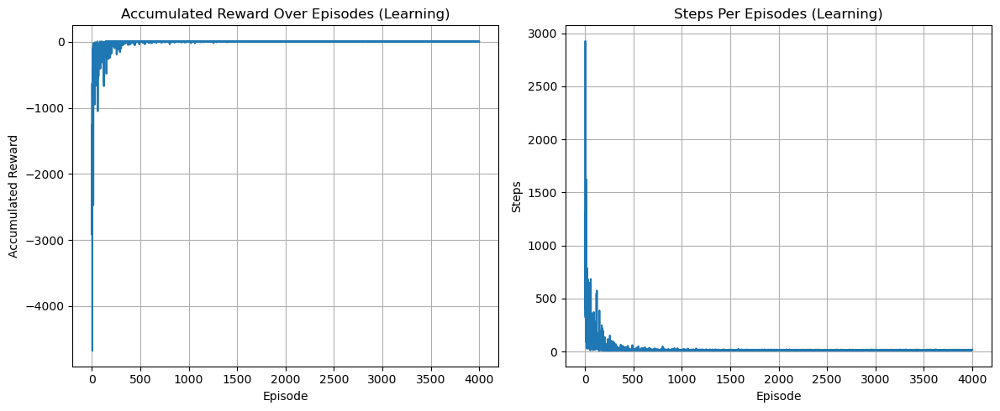

In [130]:
Q = np.zeros([n_states, n_actions])
episodes = 4001
alpha = 0.3
gamma = 0.9
epsilon = 0
tau = 0.25
policy = "softmax"
update_rule = "SARSA"

Q_SARSA, rewards, steps = train(Q, episodes, alpha, gamma, epsilon, tau, policy, update_rule)
np.save('sarsa_q_table.npy', Q_SARSA)
plot_results(rewards, steps)

#### Visualize the trained agent for SARSA


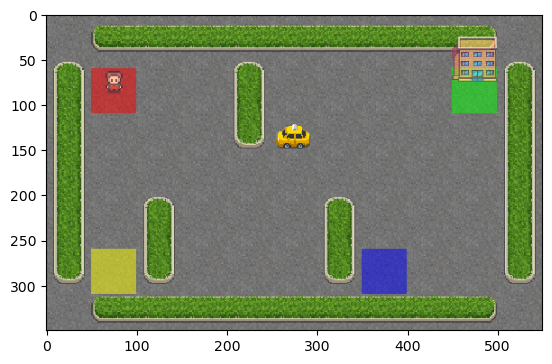

Step: 0
State: 141 , Action: 3 , Reward: -1 , Total Accumulateed Reward: -1


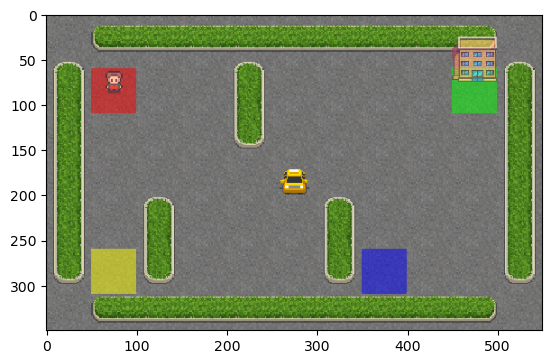

(South)
Step: 1
State: 241 , Action: 0 , Reward: -1 , Total Accumulateed Reward: -2


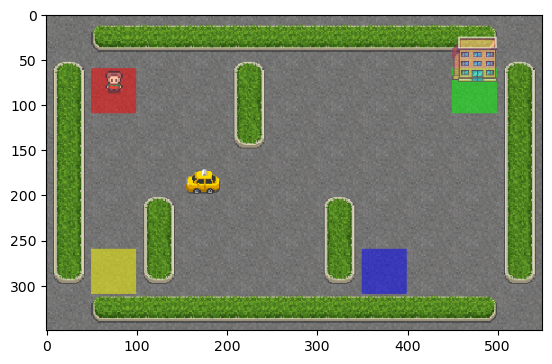

(West)
Step: 2
State: 221 , Action: 3 , Reward: -1 , Total Accumulateed Reward: -3


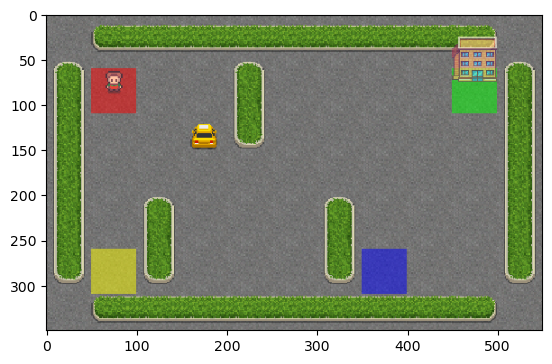

(North)
Step: 3
State: 121 , Action: 1 , Reward: -1 , Total Accumulateed Reward: -4


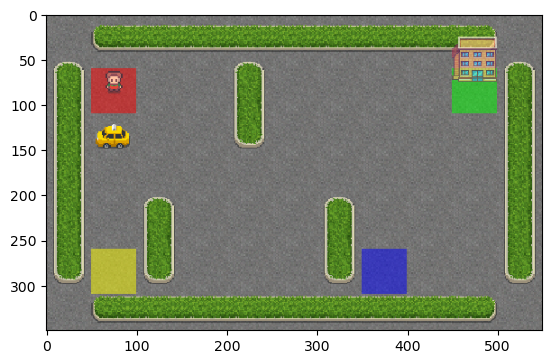

(West)
Step: 4
State: 101 , Action: 3 , Reward: -1 , Total Accumulateed Reward: -5


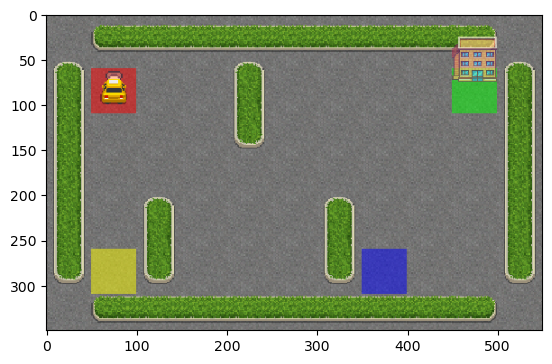

(North)
Step: 5
State: 1 , Action: 1 , Reward: -1 , Total Accumulateed Reward: -6


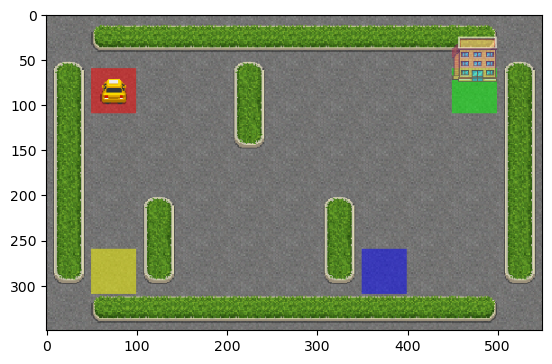

(Pickup)
Step: 6
State: 17 , Action: 4 , Reward: -1 , Total Accumulateed Reward: -7


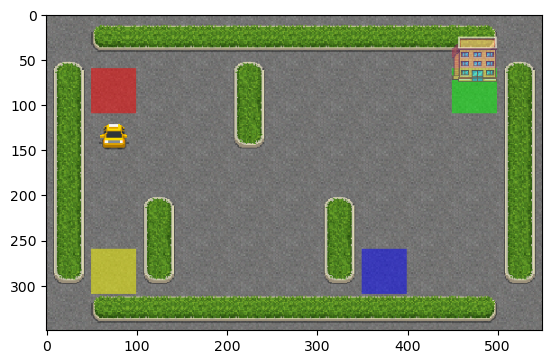

(South)
Step: 7
State: 117 , Action: 0 , Reward: -1 , Total Accumulateed Reward: -8


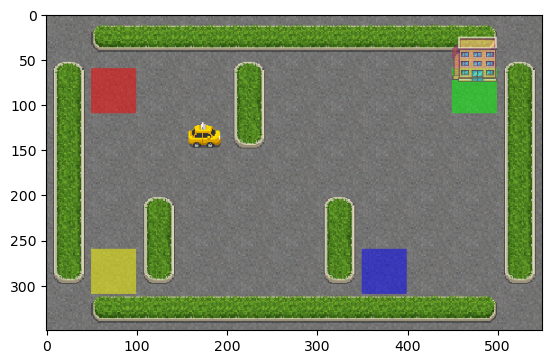

(East)
Step: 8
State: 137 , Action: 2 , Reward: -1 , Total Accumulateed Reward: -9


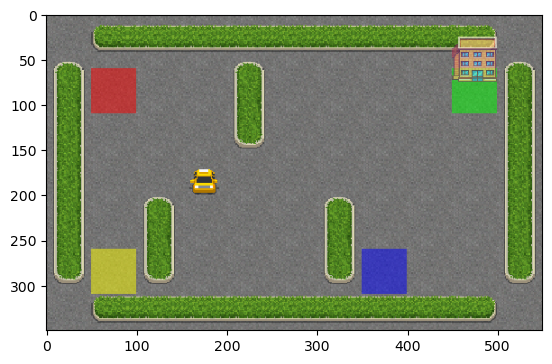

(South)
Step: 9
State: 237 , Action: 0 , Reward: -1 , Total Accumulateed Reward: -10


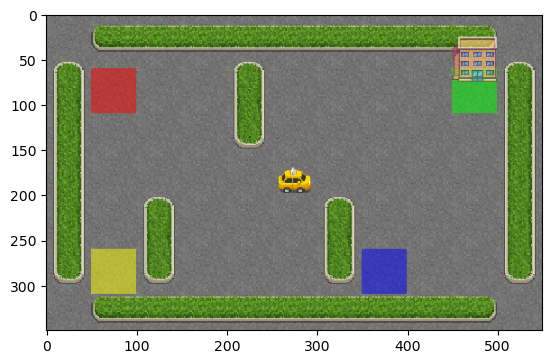

(East)
Step: 10
State: 257 , Action: 2 , Reward: -1 , Total Accumulateed Reward: -11


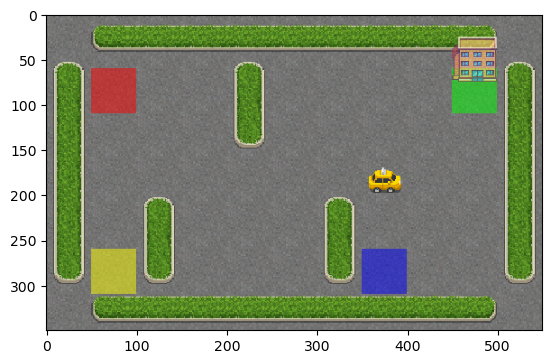

(East)
Step: 11
State: 277 , Action: 2 , Reward: -1 , Total Accumulateed Reward: -12


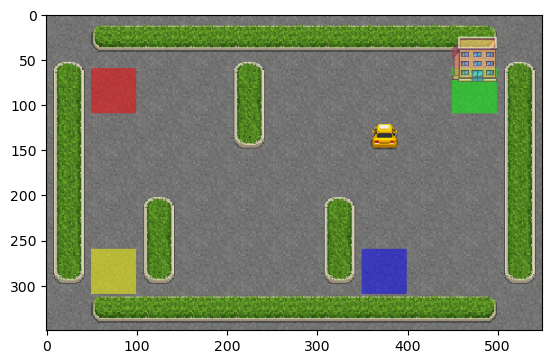

(North)
Step: 12
State: 177 , Action: 1 , Reward: -1 , Total Accumulateed Reward: -13


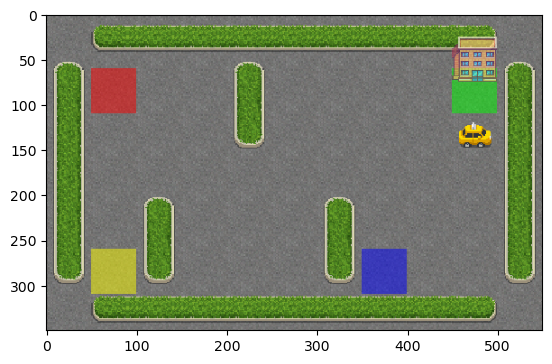

(East)
Step: 13
State: 197 , Action: 2 , Reward: -1 , Total Accumulateed Reward: -14


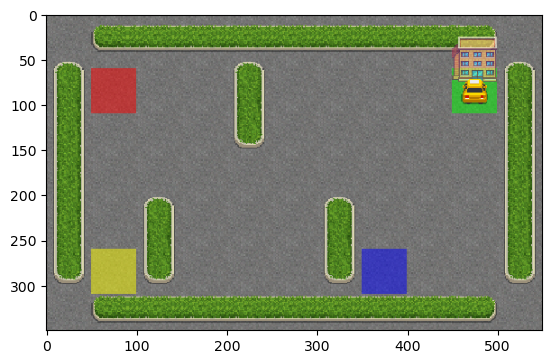

(North)
Step: 14
State: 97 , Action: 1 , Reward: -1 , Total Accumulateed Reward: -15


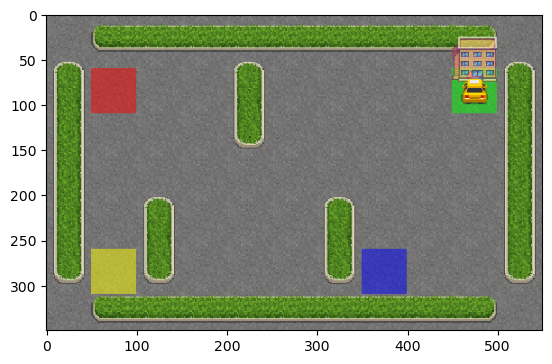

(Dropoff)
Step: 15
State: 85 , Action: 5 , Reward: 20 , Total Accumulateed Reward: 5


In [15]:
env = gym.make("Taxi-v3", render_mode="rgb_array")
visualize_agent(env, Q_SARSA)

#### Testing for both trained agent

In [ ]:
# Import packages that needed for testing
import gym
import numpy as np
from matplotlib import pyplot as plt

In [3]:
def test_agent(env, Q, num_episodes=1000):
    total_rewards = []
    total_steps = []

    for episode in range(num_episodes):
        state = env.reset()[0]
        done = False
        total_reward = 0
        steps = 0

        while not done and steps < 100:
            # Use greedy action selection
            action = np.argmax(Q[state])  
            state, reward, done, _, _ = env.step(action)
            total_reward += reward
            steps += 1

        total_rewards.append(total_reward)
        total_steps.append(steps)
        
        if steps == 100:
            print("Reached max steps: program is killed")
            break
        
    return total_rewards, total_steps

env = gym.make('Taxi-v3')
Q_QLEARNING = np.load('q_learning_q_table.npy')
Q_SARSA = np.load('sarsa_q_table.npy')   

rewards, steps = test_agent(env, Q_QLEARNING)
print("Testing Q-learning:")
print("Average Accumulated Reward:", np.mean(rewards))
print("Average Steps:", np.mean(steps))

print()

rewards, steps = test_agent(env, Q_SARSA)
print("Testing SARSA:")
print("Average Accumulated Reward:", np.mean(rewards))
print("Average Steps:", np.mean(steps))

/Users/ivanluk/opt/anaconda3/lib/python3.11/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):


Testing Q-learning:
Average Accumulated Reward: 8.021
Average Steps: 12.979

Testing SARSA:
Average Accumulated Reward: 7.916
Average Steps: 13.084


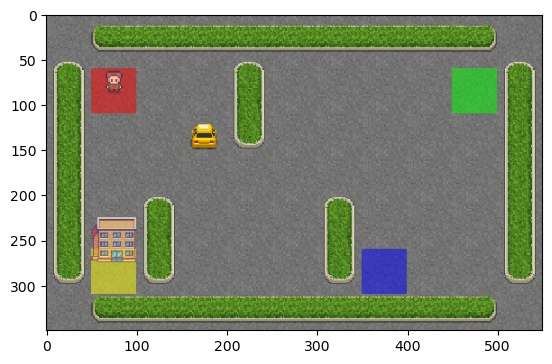

Step: 0
State: 122 , Action: 1 , Reward: -1 , Total Accumulateed Reward: -1


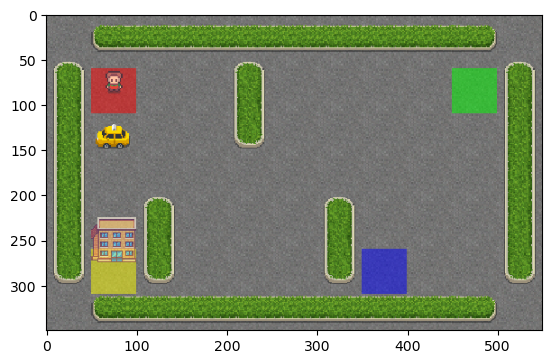

(West)
Step: 1
State: 102 , Action: 3 , Reward: -1 , Total Accumulateed Reward: -2


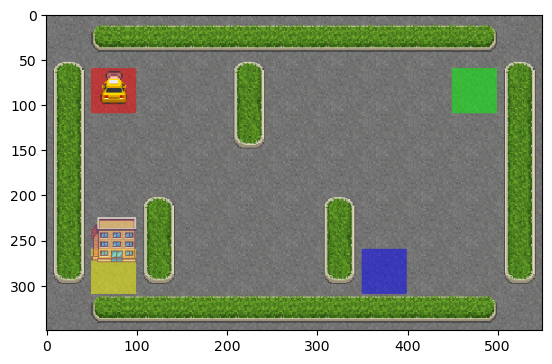

(North)
Step: 2
State: 2 , Action: 1 , Reward: -1 , Total Accumulateed Reward: -3


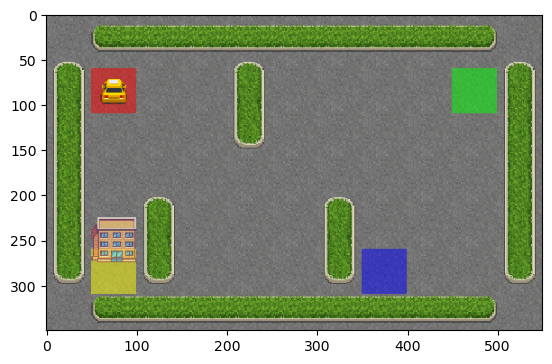

(Pickup)
Step: 3
State: 18 , Action: 4 , Reward: -1 , Total Accumulateed Reward: -4


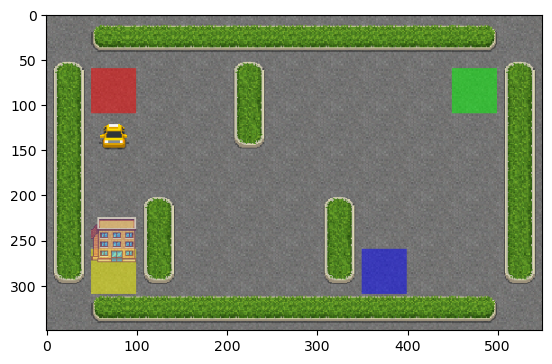

(South)
Step: 4
State: 118 , Action: 0 , Reward: -1 , Total Accumulateed Reward: -5


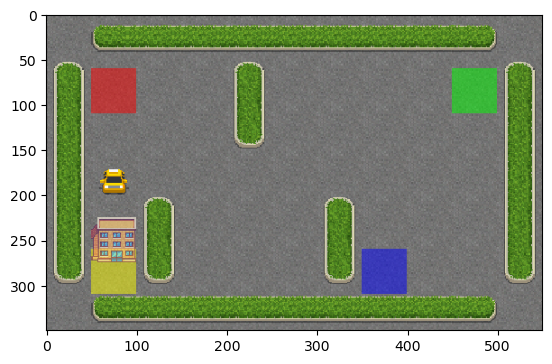

(South)
Step: 5
State: 218 , Action: 0 , Reward: -1 , Total Accumulateed Reward: -6


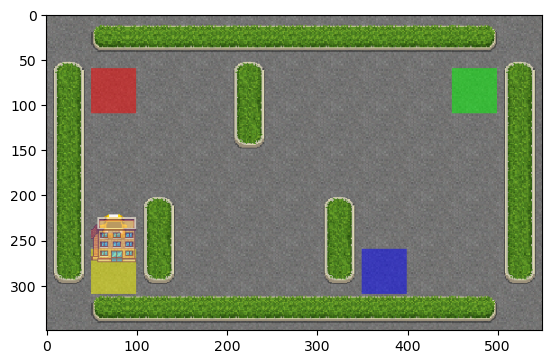

(South)
Step: 6
State: 318 , Action: 0 , Reward: -1 , Total Accumulateed Reward: -7


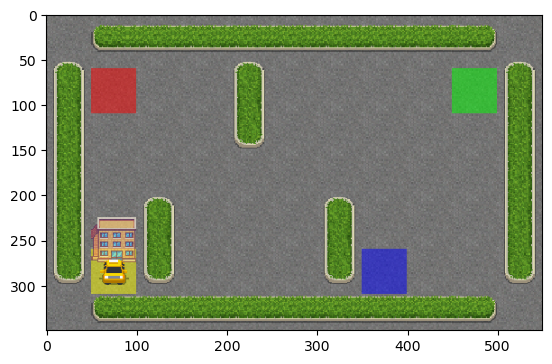

(South)
Step: 7
State: 418 , Action: 0 , Reward: -1 , Total Accumulateed Reward: -8


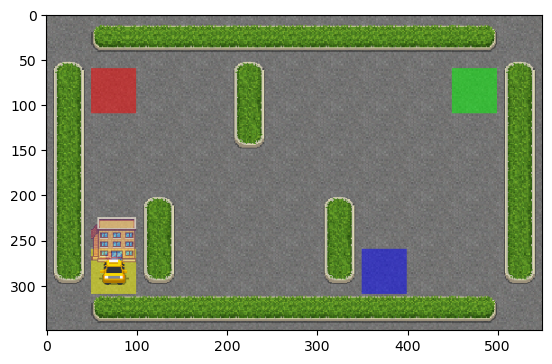

(Dropoff)
Step: 8
State: 410 , Action: 5 , Reward: 20 , Total Accumulateed Reward: 12


In [9]:
env = gym.make("Taxi-v3", render_mode="rgb_array")
visualize_agent(env, Q_QLEARNING)

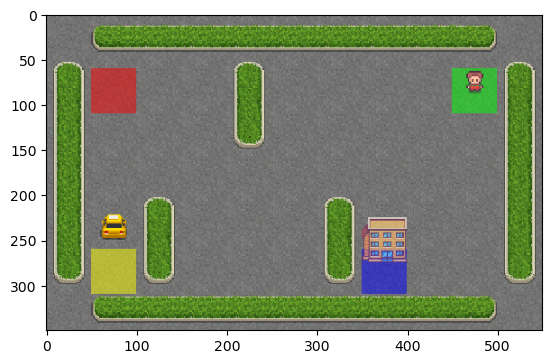

Step: 0
State: 307 , Action: 1 , Reward: -1 , Total Accumulateed Reward: -1


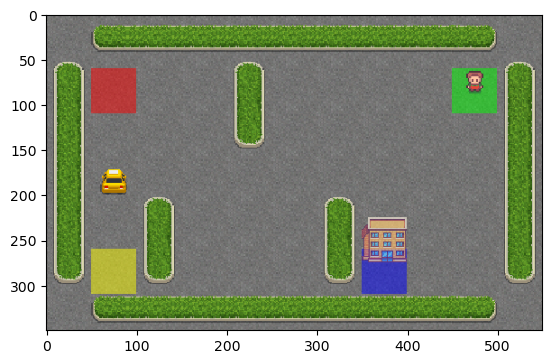

(North)
Step: 1
State: 207 , Action: 1 , Reward: -1 , Total Accumulateed Reward: -2


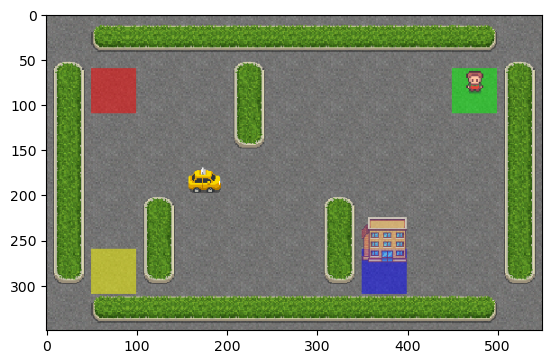

(East)
Step: 2
State: 227 , Action: 2 , Reward: -1 , Total Accumulateed Reward: -3


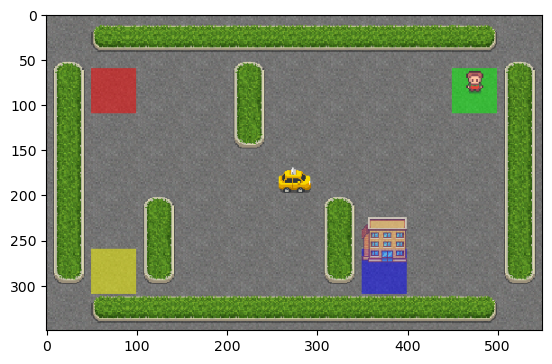

(East)
Step: 3
State: 247 , Action: 2 , Reward: -1 , Total Accumulateed Reward: -4


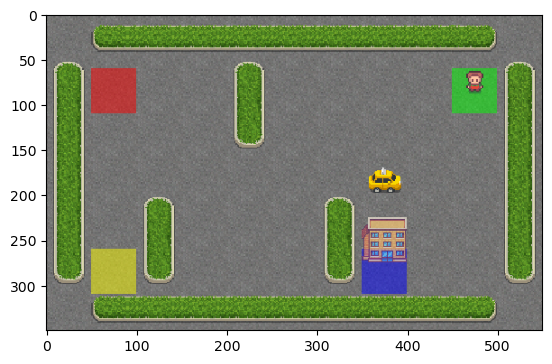

(East)
Step: 4
State: 267 , Action: 2 , Reward: -1 , Total Accumulateed Reward: -5


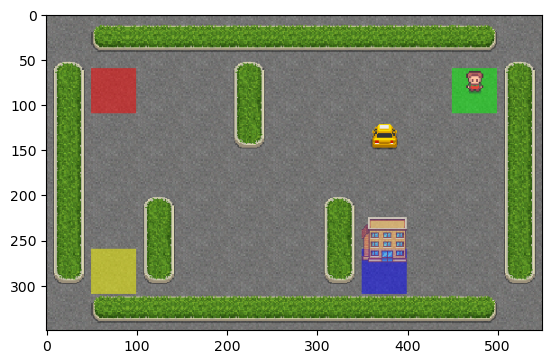

(North)
Step: 5
State: 167 , Action: 1 , Reward: -1 , Total Accumulateed Reward: -6


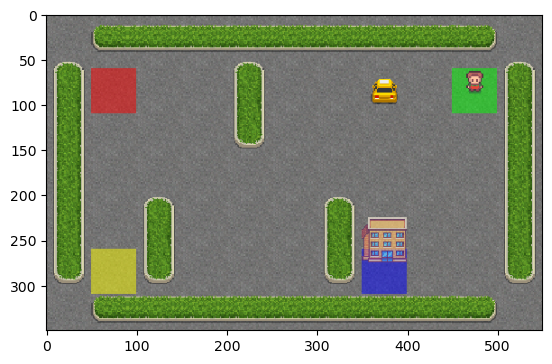

(North)
Step: 6
State: 67 , Action: 1 , Reward: -1 , Total Accumulateed Reward: -7


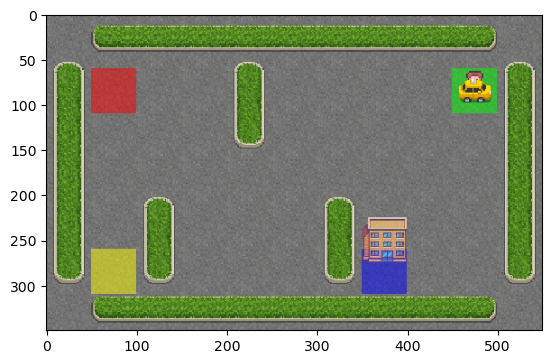

(East)
Step: 7
State: 87 , Action: 2 , Reward: -1 , Total Accumulateed Reward: -8


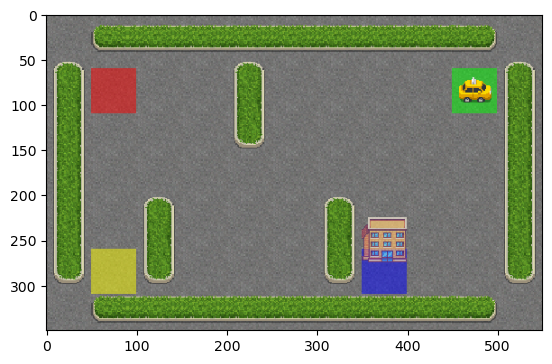

(Pickup)
Step: 8
State: 99 , Action: 4 , Reward: -1 , Total Accumulateed Reward: -9


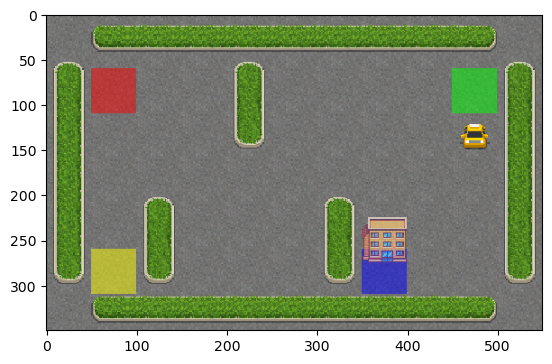

(South)
Step: 9
State: 199 , Action: 0 , Reward: -1 , Total Accumulateed Reward: -10


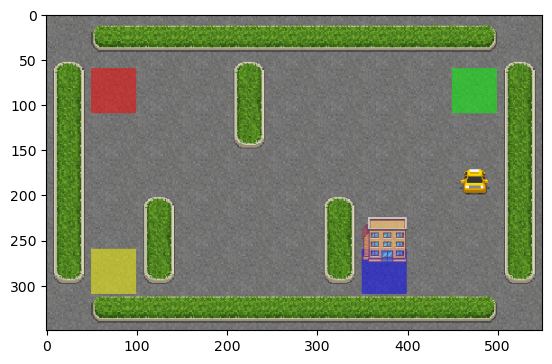

(South)
Step: 10
State: 299 , Action: 0 , Reward: -1 , Total Accumulateed Reward: -11


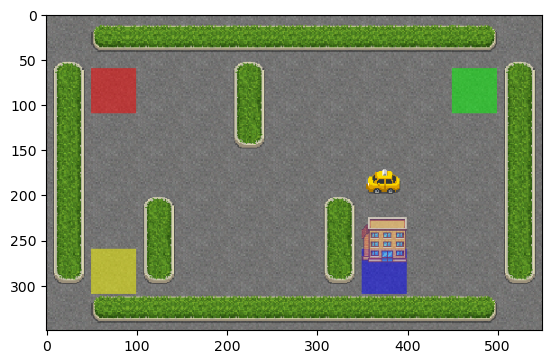

(West)
Step: 11
State: 279 , Action: 3 , Reward: -1 , Total Accumulateed Reward: -12


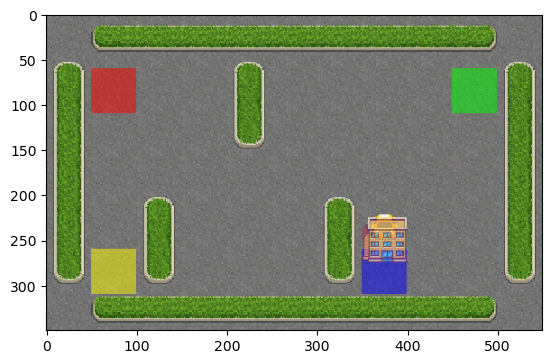

(South)
Step: 12
State: 379 , Action: 0 , Reward: -1 , Total Accumulateed Reward: -13


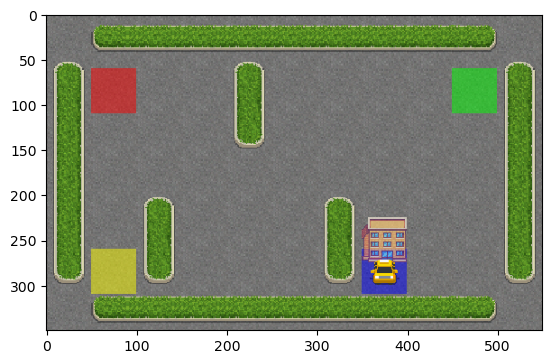

(South)
Step: 13
State: 479 , Action: 0 , Reward: -1 , Total Accumulateed Reward: -14


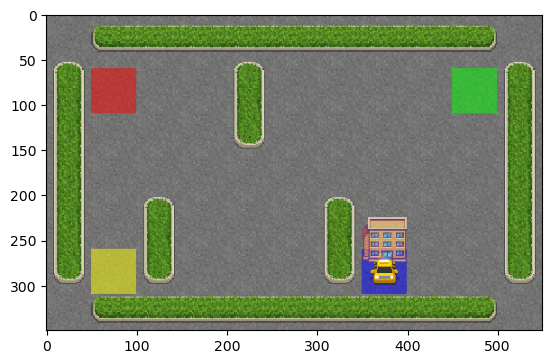

(Dropoff)
Step: 14
State: 475 , Action: 5 , Reward: 20 , Total Accumulateed Reward: 6


In [10]:
env = gym.make("Taxi-v3", render_mode="rgb_array")
visualize_agent(env, Q_SARSA)